## Final Project Submission

Please fill out:
* Student name: 
* Student pace: self paced / part time / full time
* Scheduled project review date/time: 
* Instructor name: 
* Blog post URL:


In [849]:
# Your code here - remember to use markdown cells for comments as well!
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sqlite3
import seaborn as sns
%matplotlib inline

# 1. bom_movie dataframe

In [850]:
bom_movie = pd.read_csv('zippedData/bom.movie_gross.csv')


In [851]:
bom_movie.shape


(3387, 5)

In [852]:
bom_movie.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3387 entries, 0 to 3386
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   title           3387 non-null   object 
 1   studio          3382 non-null   object 
 2   domestic_gross  3359 non-null   float64
 3   foreign_gross   2037 non-null   object 
 4   year            3387 non-null   int64  
dtypes: float64(1), int64(1), object(3)
memory usage: 132.4+ KB


In [853]:
bom_movie.isna().sum()

title                0
studio               5
domestic_gross      28
foreign_gross     1350
year                 0
dtype: int64

In [854]:
bom_movie.head(5)

,title,studio,domestic_gross,foreign_gross,year
0,Toy Story 3,BV,415000000.0,652000000,2010
1,Alice in Wonderland (2010),BV,334200000.0,691300000,2010
2,Harry Potter and the Deathly Hallows Part 1,WB,296000000.0,664300000,2010
3,Inception,WB,292600000.0,535700000,2010
4,Shrek Forever After,P/DW,238700000.0,513900000,2010


In [1428]:
bom_movie[bom_movie.title == "Inception"]

,title,studio,domestic_gross,foreign_gross,year,title_year,titleyear
3,Inception,WB,292600000.0,535700000,2010,Inception2010,Inception2010


In [1369]:
bom_movie['title_year'] = bom_movie['title'] + bom_movie['year'].astype(str)
bom_movie.head()

,title,studio,domestic_gross,foreign_gross,year,title_year,titleyear
0,Toy Story 3,BV,415000000.0,652000000,2010,Toy Story 32010,Toy Story 32010
1,Alice in Wonderland (2010),BV,334200000.0,691300000,2010,Alice in Wonderland (2010)2010,Alice in Wonderland (2010)2010
2,Harry Potter and the Deathly Hallows Part 1,WB,296000000.0,664300000,2010,Harry Potter and the Deathly Hallows Part 12010,Harry Potter and the Deathly Hallows Part 12010
3,Inception,WB,292600000.0,535700000,2010,Inception2010,Inception2010
4,Shrek Forever After,P/DW,238700000.0,513900000,2010,Shrek Forever After2010,Shrek Forever After2010


In [1370]:
bom_movie.title_year.nunique()

3387

In [1366]:
#Get "genres" from movies_basics: combine with left
bom_movie_genres = pd.merge(bom_movie,movie_basics_df, left_on = 'title', right_on = 'primary_title', how = 'left')

In [856]:
bom_movie_genres.head()

,title,studio,domestic_gross,foreign_gross,year,movie_id,primary_title,original_title,start_year,runtime_minutes,genres
0,Toy Story 3,BV,415000000.0,652000000,2010,tt0435761,Toy Story 3,Toy Story 3,2010.0,103.0,"Adventure,Animation,Comedy"
1,Alice in Wonderland (2010),BV,334200000.0,691300000,2010,NaN,NaN,NaN,NaN,NaN,NaN
2,Harry Potter and the Deathly Hallows Part 1,WB,296000000.0,664300000,2010,NaN,NaN,NaN,NaN,NaN,NaN
3,Inception,WB,292600000.0,535700000,2010,tt1375666,Inception,Inception,2010.0,148.0,"Action,Adventure,Sci-Fi"
4,Shrek Forever After,P/DW,238700000.0,513900000,2010,tt0892791,Shrek Forever After,Shrek Forever After,2010.0,93.0,"Adventure,Animation,Comedy"


In [857]:
bom_movie_genres.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4147 entries, 0 to 4146
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   title            4147 non-null   object 
 1   studio           4142 non-null   object 
 2   domestic_gross   4112 non-null   float64
 3   foreign_gross    2516 non-null   object 
 4   year             4147 non-null   int64  
 5   movie_id         3366 non-null   object 
 6   primary_title    3366 non-null   object 
 7   original_title   3366 non-null   object 
 8   start_year       3366 non-null   float64
 9   runtime_minutes  3198 non-null   float64
 10  genres           3326 non-null   object 
dtypes: float64(3), int64(1), object(7)
memory usage: 356.5+ KB


In [858]:
#Get "production budget" from tn_movie: combine with left:
bom_movie_genres_budget = pd.merge(bom_movie_genres,tn_movie, left_on = 'title', right_on = 'movie', how = 'left')

In [859]:
bom_movie_genres_budget.head()

,title,studio,domestic_gross_x,foreign_gross,year,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,id,release_date,movie,production_budget,domestic_gross_y,worldwide_gross
0,Toy Story 3,BV,415000000.0,652000000,2010,tt0435761,Toy Story 3,Toy Story 3,2010.0,103.0,"Adventure,Animation,Comedy",47.0,"Jun 18, 2010",Toy Story 3,"$200,000,000","$415,004,880","$1,068,879,522"
1,Alice in Wonderland (2010),BV,334200000.0,691300000,2010,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Harry Potter and the Deathly Hallows Part 1,WB,296000000.0,664300000,2010,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Inception,WB,292600000.0,535700000,2010,tt1375666,Inception,Inception,2010.0,148.0,"Action,Adventure,Sci-Fi",38.0,"Jul 16, 2010",Inception,"$160,000,000","$292,576,195","$835,524,642"
4,Shrek Forever After,P/DW,238700000.0,513900000,2010,tt0892791,Shrek Forever After,Shrek Forever After,2010.0,93.0,"Adventure,Animation,Comedy",27.0,"May 21, 2010",Shrek Forever After,"$165,000,000","$238,736,787","$756,244,673"


In [860]:
bom_movie_genres_budget.columns

Index(['title', 'studio', 'domestic_gross_x', 'foreign_gross', 'year',
       'movie_id', 'primary_title', 'original_title', 'start_year',
       'runtime_minutes', 'genres', 'id', 'release_date', 'movie',
       'production_budget', 'domestic_gross_y', 'worldwide_gross'],
      dtype='object')

In [861]:
bom_movie_genres_budget.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4175 entries, 0 to 4174
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   title              4175 non-null   object 
 1   studio             4170 non-null   object 
 2   domestic_gross_x   4140 non-null   float64
 3   foreign_gross      2539 non-null   object 
 4   year               4175 non-null   int64  
 5   movie_id           3394 non-null   object 
 6   primary_title      3394 non-null   object 
 7   original_title     3394 non-null   object 
 8   start_year         3394 non-null   float64
 9   runtime_minutes    3222 non-null   float64
 10  genres             3351 non-null   object 
 11  id                 1682 non-null   float64
 12  release_date       1682 non-null   object 
 13  movie              1682 non-null   object 
 14  production_budget  1682 non-null   object 
 15  domestic_gross_y   1682 non-null   object 
 16  worldwide_gross    1682 

In [862]:
bom_movie_genres_budget["domestic_gross_numeric"] = [float(str(i).replace(",", "")) for i in bom_movie_genres_budget["domestic_gross_x"]]
bom_movie_genres_budget["foreign_gross_numeric"] = [float(str(i).replace(",", "")) for i in bom_movie_genres_budget["foreign_gross"]]


In [863]:
bom_movie_genres_budget["total_gross_numeric"] = bom_movie_genres_budget["domestic_gross_numeric"] + bom_movie_genres_budget["foreign_gross_numeric"]

In [931]:
bom_movie_genres_budget_subset = bom_movie_genres_budget[['runtime_minutes',"domestic_gross_numeric","foreign_gross_numeric","total_gross_numeric","genres","studio"]]

In [740]:
# # bom_movie_genres_budget_subset = bom_movie_genres_budget_subset[(bom_movie_genres_budget_subset.runtime_minutes <= 200) & (bom_movie_genres_budget_subset.total_gross_numeric <= 500000000)]
# bom_movie_genres_budget_subset = bom_movie_genres_budget_subset[(bom_movie_genres_budget_subset.runtime_minutes <= 200)]

In [932]:
bom_movie_genres_budget_subset

,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric,genres,studio
0,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV
1,NaN,334200000.0,691300000.0,1.025500e+09,NaN,BV
2,NaN,296000000.0,664300000.0,9.603000e+08,NaN,WB
3,148.0,292600000.0,535700000.0,8.283000e+08,"Action,Adventure,Sci-Fi",WB
4,93.0,238700000.0,513900000.0,7.526000e+08,"Adventure,Animation,Comedy",P/DW
...,...,...,...,...,...,...
4170,106.0,6200.0,NaN,NaN,"Action,Drama,Thriller",Magn.
4171,NaN,4800.0,NaN,NaN,NaN,FM
4172,NaN,2500.0,NaN,NaN,NaN,Sony
4173,NaN,2400.0,NaN,NaN,NaN,Synergetic


In [942]:
bom_movie_genres_budget_subset.columns

Index(['runtime_minutes', 'domestic_gross_numeric', 'foreign_gross_numeric',
       'total_gross_numeric', 'genres', 'studio'],
      dtype='object')

In [943]:
bom_movie_genres_budget_subset['each_genre'] = bom_movie_genres_budget_subset['genres']

In [944]:
bom_movie_genres_budget_subset

,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric,genres,studio,each_genre
0,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV,"Adventure,Animation,Comedy"
1,NaN,334200000.0,691300000.0,1.025500e+09,NaN,BV,NaN
2,NaN,296000000.0,664300000.0,9.603000e+08,NaN,WB,NaN
3,148.0,292600000.0,535700000.0,8.283000e+08,"Action,Adventure,Sci-Fi",WB,"Action,Adventure,Sci-Fi"
4,93.0,238700000.0,513900000.0,7.526000e+08,"Adventure,Animation,Comedy",P/DW,"Adventure,Animation,Comedy"
...,...,...,...,...,...,...,...
4170,106.0,6200.0,NaN,NaN,"Action,Drama,Thriller",Magn.,"Action,Drama,Thriller"
4171,NaN,4800.0,NaN,NaN,NaN,FM,NaN
4172,NaN,2500.0,NaN,NaN,NaN,Sony,NaN
4173,NaN,2400.0,NaN,NaN,NaN,Synergetic,NaN


In [945]:
bom_movie_genres_budget_subset = bom_movie_genres_budget_subset.set_index(['runtime_minutes', 'domestic_gross_numeric', 'foreign_gross_numeric',
       'total_gross_numeric',"genres", "studio"]).apply(lambda x: x.str.split(',').explode()).reset_index()

In [946]:
bom_movie_genres_budget_subset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8309 entries, 0 to 8308
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   runtime_minutes         7315 non-null   float64
 1   domestic_gross_numeric  8246 non-null   float64
 2   foreign_gross_numeric   5249 non-null   float64
 3   total_gross_numeric     5186 non-null   float64
 4   genres                  7485 non-null   object 
 5   studio                  8301 non-null   object 
 6   each_genre              7485 non-null   object 
dtypes: float64(4), object(3)
memory usage: 454.5+ KB


In [947]:
bom_movie_genres_budget_subset

,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric,genres,studio,each_genre
0,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV,Adventure
1,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV,Animation
2,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV,Comedy
3,NaN,334200000.0,691300000.0,1.025500e+09,NaN,BV,NaN
4,NaN,296000000.0,664300000.0,9.603000e+08,NaN,WB,NaN
...,...,...,...,...,...,...,...
8304,106.0,6200.0,NaN,NaN,"Action,Drama,Thriller",Magn.,Thriller
8305,NaN,4800.0,NaN,NaN,NaN,FM,NaN
8306,NaN,2500.0,NaN,NaN,NaN,Sony,NaN
8307,NaN,2400.0,NaN,NaN,NaN,Synergetic,NaN


In [ ]:
bom_movie_genres_budget_subset.style.format({'runtime_minutes': '{:,.2f}', 'domestic_gross_numeric': '{:,.2f}', 'foreign_gross_numeric': '{:,.2f}',
       'total_gross_numeric': '{:,.2f}'})

In [949]:
Mean_bom_movie_each_genre = bom_movie_genres_budget_subset.groupby('each_genre').mean(numeric_only = True).sort_values('total_gross_numeric',ascending=False)
Mean_bom_movie_each_genre.style.format({'runtime_minutes': '{:,.2f}', 'domestic_gross_numeric': '{:,.2f}', 'foreign_gross_numeric': '{:,.2f}',
       'total_gross_numeric': '{:,.2f}'})

,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric
each_genre,,,,
Sci-Fi,113.34,"107,851,207.19","204,193,063.70","336,241,953.81"
Adventure,109.57,"94,396,825.44","208,493,455.26","321,612,895.96"
Animation,94.81,"87,326,187.17","202,113,421.86","310,517,547.21"
Action,115.08,"58,735,400.14","143,717,780.28","225,953,110.67"
Fantasy,110.03,"52,777,121.02","136,852,571.32","206,125,256.29"
Family,100.57,"44,426,597.69","89,915,146.32","151,584,570.21"
Musical,121.18,"28,992,436.84","74,118,530.00","128,573,430.00"
Sport,110.36,"37,238,514.04","66,245,785.71","123,521,465.71"
Comedy,104.71,"33,748,276.52","72,943,801.57","123,511,837.27"


In [950]:
Mean_bom_movie_each_genre.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22 entries, Sci-Fi to News
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   runtime_minutes         22 non-null     float64
 1   domestic_gross_numeric  22 non-null     float64
 2   foreign_gross_numeric   22 non-null     float64
 3   total_gross_numeric     22 non-null     float64
dtypes: float64(4)
memory usage: 1.4+ KB


In [951]:
Mean_bom_movie_genres = bom_movie_genres_budget_subset.groupby('genres').mean(numeric_only = True).sort_values('total_gross_numeric',ascending=False)
Mean_bom_movie_genres.style.format({'runtime_minutes': '{:,.2f}', 'domestic_gross_numeric': '{:,.2f}', 'foreign_gross_numeric': '{:,.2f}',
       'total_gross_numeric': '{:,.2f}'})

,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric
genres,,,,
"Adventure,Drama,Sport",93.00,"400,700,000.00","875,700,000.00","1,276,400,000.00"
"Documentary,Drama,Sport",90.50,"206,725,000.00","409,300,000.00","821,900,000.00"
Sci-Fi,69.67,"83,020,020.00","409,300,000.00","821,900,000.00"
"Adventure,Fantasy",139.67,"192,899,999.67","511,133,333.33","704,033,333.00"
"Fantasy,Romance",107.00,"200,521,500.00","458,500,000.00","659,021,500.00"
"Adventure,Drama,Sci-Fi",156.50,"208,200,000.00","445,550,000.00","653,750,000.00"
"Action,Adventure,Sci-Fi",130.62,"234,568,085.09","361,117,443.24","600,737,008.43"
"Comedy,Mystery",114.50,"63,674,700.00","332,300,000.00","586,800,000.00"
"Biography,Drama,Musical",105.00,"174,300,000.00","260,700,000.00","435,000,000.00"


In [1043]:
bom_movie_genres_budget_subset

,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric,genres,studio,each_genre
0,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV,Adventure
1,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV,Animation
2,103.0,415000000.0,652000000.0,1.067000e+09,"Adventure,Animation,Comedy",BV,Comedy
3,NaN,334200000.0,691300000.0,1.025500e+09,NaN,BV,NaN
4,NaN,296000000.0,664300000.0,9.603000e+08,NaN,WB,NaN
...,...,...,...,...,...,...,...
8304,106.0,6200.0,NaN,NaN,"Action,Drama,Thriller",Magn.,Thriller
8305,NaN,4800.0,NaN,NaN,NaN,FM,NaN
8306,NaN,2500.0,NaN,NaN,NaN,Sony,NaN
8307,NaN,2400.0,NaN,NaN,NaN,Synergetic,NaN


In [1047]:
Mean_bom_movie_studios = bom_movie_genres_budget_subset.groupby(['each_genre','studio']).mean(numeric_only = True).sort_values('total_gross_numeric',ascending=False)
Mean_bom_movie_studios.style.format({'runtime_minutes': '{:,.2f}', 'domestic_gross_numeric': '{:,.2f}', 'foreign_gross_numeric': '{:,.2f}',
       'total_gross_numeric': '{:,.2f}'})

,,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric
each_genre,studio,,,,
Sci-Fi,P/DW,154.00,"352,400,000.00","771,400,000.00","1,123,800,000.00"
Family,WB (NL),169.00,"303,000,000.00","718,100,000.00","1,021,100,000.00"
Music,Fox,134.00,"216,400,000.00","687,200,000.00","903,600,000.00"
Sci-Fi,BV,134.78,"397,244,444.44","492,066,818.83","889,311,263.28"
Action,HC,123.00,"2,700,000.00","867,600,000.00","870,300,000.00"
Drama,HC,123.00,"2,700,000.00","867,600,000.00","870,300,000.00"
Thriller,HC,123.00,"2,700,000.00","867,600,000.00","870,300,000.00"
Animation,Uni.,84.00,"261,725,000.00","471,425,000.00","733,150,000.00"
Action,BV,127.07,"275,423,333.33","416,590,045.65","692,013,378.98"


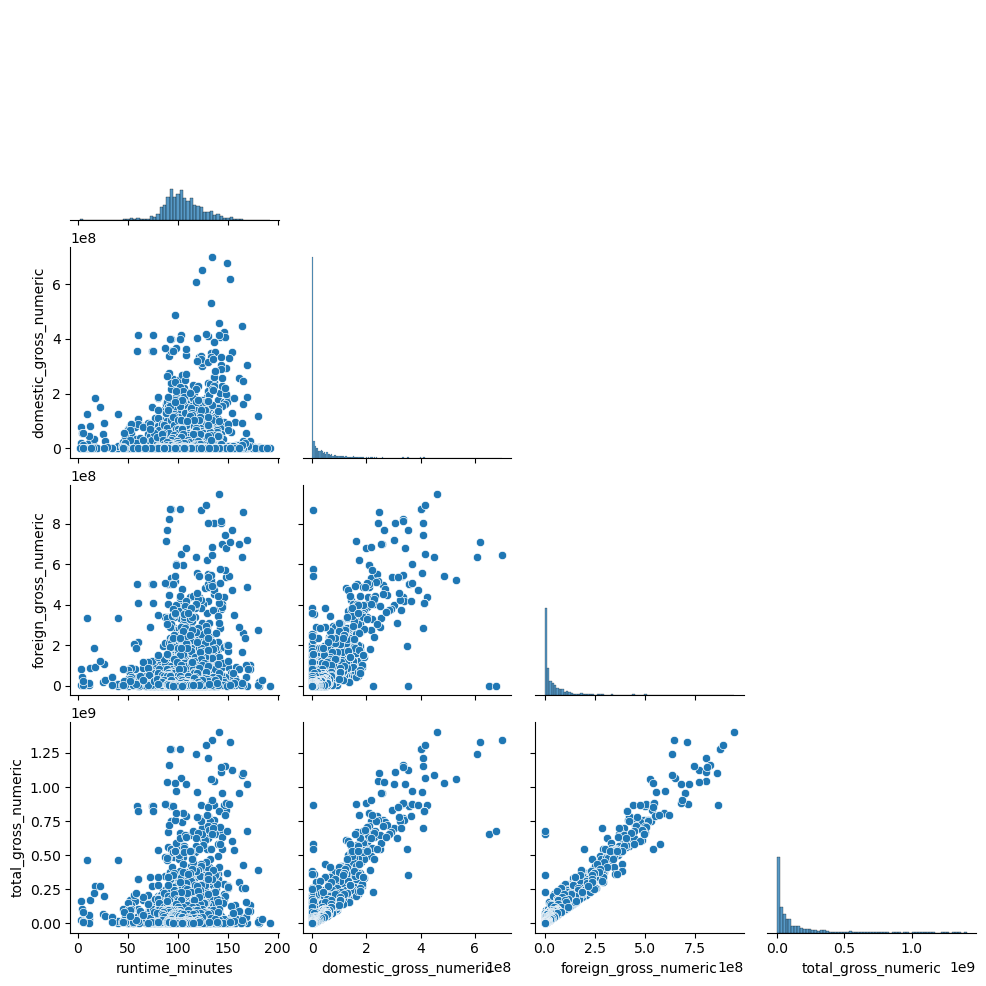

In [572]:
#Visualize with pairplot:
sns.pairplot(bom_movie_genres_budget_subset, corner = True)
plt.show()

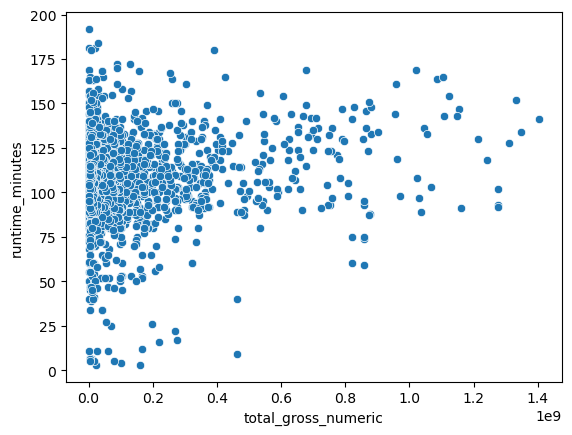

In [573]:
#Use scatter plot:
sns.scatterplot(x = 'total_gross_numeric', y = 'runtime_minutes', data = bom_movie_genres_budget_subset )
plt.show()


<Axes: >

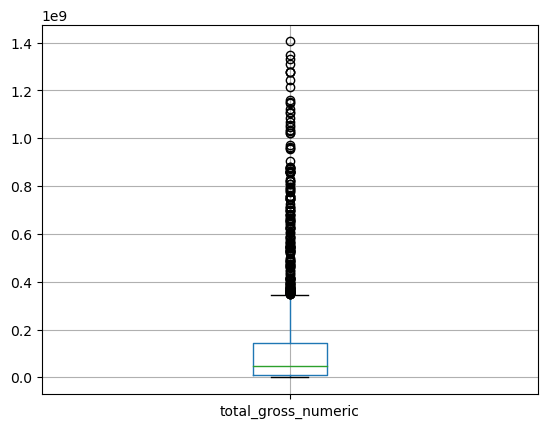

In [574]:
bom_movie_genres_budget_subset.boxplot('total_gross_numeric')

In [790]:
bom_movie_genres_subset.isna().sum()

runtime_minutes            949
domestic_gross_numeric      35
foreign_gross_numeric     1631
dtype: int64

In [404]:
bom_movie_genres_subset = bom_movie_genres_subset.dropna(axis = "index")

In [405]:
bom_movie_genres_subset.head()

,runtime_minutes,domestic_gross_numeric,foreign_gross_numeric
0,103.0,415000000.0,652000000.0
1,148.0,292600000.0,535700000.0
2,93.0,238700000.0,513900000.0
3,124.0,300500000.0,398000000.0
4,124.0,312400000.0,311500000.0


In [406]:
bom_movie_genres_subset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1902 entries, 0 to 3335
Data columns (total 3 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   runtime_minutes         1902 non-null   float64
 1   domestic_gross_numeric  1902 non-null   float64
 2   foreign_gross_numeric   1902 non-null   float64
dtypes: float64(3)
memory usage: 59.4 KB


<Axes: >

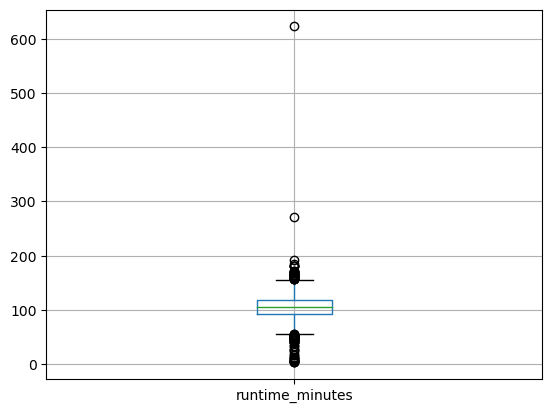

In [407]:
bom_movie_genres_subset.boxplot('runtime_minutes')

# 2. tmdb_movie dataframe

In [1686]:
tmdb_movie = pd.read_csv('zippedData/tmdb.movies.csv')

In [1679]:
tmdb_movie.shape

(26517, 10)

In [1687]:
tmdb_movie.head()

,Unnamed: 0,genre_ids,id,original_language,original_title,popularity,release_date,title,vote_average,vote_count
0,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788
1,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610
2,2,"[12, 28, 878]",10138,en,Iron Man 2,28.515,2010-05-07,Iron Man 2,6.8,12368
3,3,"[16, 35, 10751]",862,en,Toy Story,28.005,1995-11-22,Toy Story,7.9,10174
4,4,"[28, 878, 12]",27205,en,Inception,27.920,2010-07-16,Inception,8.3,22186


In [1681]:
#Copy genre_ids into each_genre_id:
tmdb_movie['each_genre_id'] = tmdb_movie['genre_ids']

In [889]:
tmdb_movie.columns

Index(['Unnamed: 0', 'genre_ids', 'id', 'original_language', 'original_title',
       'popularity', 'release_date', 'title', 'vote_average', 'vote_count',
       'each_genre_id'],
      dtype='object')

In [1688]:
split_tmdb_movie = tmdb_movie.set_index(['Unnamed: 0', 'genre_ids', 'id', 'original_language', 'original_title',
       'popularity', 'release_date', 'title', 'vote_average', 'vote_count']).apply(lambda x: x.str.split(',').explode()).reset_index()

In [1685]:
split_tmdb_movie['each_genre_id'] = split_tmdb_movie['each_genre_id'].str.replace("[", '')
split_tmdb_movie['each_genre_id'] = split_tmdb_movie['each_genre_id'].str.replace("]", '')
split_tmdb_movie

,Unnamed: 0,genre_ids,id,original_language,original_title,popularity,release_date,title,vote_average,vote_count,each_genre_id
0,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,12
1,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,14
2,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,10751
3,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610,14
4,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610,12
...,...,...,...,...,...,...,...,...,...,...,...
47829,26515,"[10751, 12, 28]",366854,en,Trailer Made,0.600,2018-06-22,Trailer Made,0.0,1,10751
47830,26515,"[10751, 12, 28]",366854,en,Trailer Made,0.600,2018-06-22,Trailer Made,0.0,1,12
47831,26515,"[10751, 12, 28]",366854,en,Trailer Made,0.600,2018-06-22,Trailer Made,0.0,1,28
47832,26516,"[53, 27]",309885,en,The Church,0.600,2018-10-05,The Church,0.0,1,53


In [1692]:
split_tmdb_movie.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26517 entries, 0 to 26516
Data columns (total 10 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         26517 non-null  int64  
 1   genre_ids          26517 non-null  object 
 2   id                 26517 non-null  int64  
 3   original_language  26517 non-null  object 
 4   original_title     26517 non-null  object 
 5   popularity         26517 non-null  float64
 6   release_date       26517 non-null  object 
 7   title              26517 non-null  object 
 8   vote_average       26517 non-null  float64
 9   vote_count         26517 non-null  int64  
dtypes: float64(2), int64(3), object(5)
memory usage: 2.0+ MB


In [1693]:
split_tmdb_movie.head()

,Unnamed: 0,genre_ids,id,original_language,original_title,popularity,release_date,title,vote_average,vote_count
0,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788
1,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610
2,2,"[12, 28, 878]",10138,en,Iron Man 2,28.515,2010-05-07,Iron Man 2,6.8,12368
3,3,"[16, 35, 10751]",862,en,Toy Story,28.005,1995-11-22,Toy Story,7.9,10174
4,4,"[28, 878, 12]",27205,en,Inception,27.920,2010-07-16,Inception,8.3,22186


In [1032]:
tmdb_movie_genres = pd.merge(tmdb_movie,genre_lookup_df, left_on = "each_genre_id", right_on = 'Genre code', how = "left")

In [1033]:
tmdb_movie_genres.head()

,Unnamed: 0,genre_ids,id,original_language,original_title,popularity,release_date,title,vote_average,vote_count,each_genre_id,Genre type,Genre code
0,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,12,Adventure,12
1,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,14,Fantasy,14
2,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,10751,Family,10751
3,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610,14,Fantasy,14
4,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610,12,Adventure,12


In [1030]:

tmdb_movie_genres_studio = pd.merge(tmdb_movie_genres,bom_movie_genres_budget, left_on = "title", right_on = 'title', how = "left")
tmdb_movie_genres_studio.head()


,Unnamed: 0,genre_ids,id_x,original_language,original_title_x,popularity,release_date_x,title,vote_average,vote_count,...,genres,id_y,release_date_y,movie,production_budget,domestic_gross_y,worldwide_gross,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric
0,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610,...,"Action,Adventure,Animation",30.0,"Mar 26, 2010",How to Train Your Dragon,"$165,000,000","$217,581,232","$494,870,992",217600000.0,277300000.0,494900000.0
4,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610,...,"Action,Adventure,Animation",30.0,"Mar 26, 2010",How to Train Your Dragon,"$165,000,000","$217,581,232","$494,870,992",217600000.0,277300000.0,494900000.0


In [1021]:
tmdb_movie_genres_studio.shape

(50403, 32)

In [1035]:
tmdb_movie_genres_studio_subset = tmdb_movie_genres_studio[['vote_average','popularity','vote_count','studio','domestic_gross_numeric','foreign_gross_numeric','total_gross_numeric','Genre type']]
tmdb_movie_genres_studio_subset.head()

,vote_average,popularity,vote_count,studio,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric,Genre type
0,7.7,33.533,10788,NaN,NaN,NaN,NaN,Adventure
1,7.7,33.533,10788,NaN,NaN,NaN,NaN,Fantasy
2,7.7,33.533,10788,NaN,NaN,NaN,NaN,Family
3,7.7,28.734,7610,P/DW,217600000.0,277300000.0,494900000.0,Fantasy
4,7.7,28.734,7610,P/DW,217600000.0,277300000.0,494900000.0,Adventure


In [1036]:
#Mean sorted by total_gross_numeric:
mean_tmdb_movie_genres_studio_subset = tmdb_movie_genres_studio_subset.groupby('studio').mean(numeric_only = True).sort_values('total_gross_numeric',ascending=False)
mean_tmdb_movie_genres_studio_subset.style.format({'vote_count': '{:,.2f}','popularity': '{:,.2f}' ,'vote_average': '{:,.2f}','domestic_gross_numeric': '{:,.2f}', 'foreign_gross_numeric': '{:,.2f}',
       'total_gross_numeric': '{:,.2f}'})

,vote_average,popularity,vote_count,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric
studio,,,,,,
BV,6.92,21.37,"6,061.52","234,320,960.97","343,031,924.04","579,550,628.47"
P/DW,6.59,15.68,"3,588.88","181,138,235.29","368,188,235.29","549,326,470.59"
Sony,6.09,15.74,"2,857.32","94,386,010.88","165,261,956.35","261,547,945.02"
Fox,6.31,15.26,"3,245.65","89,326,987.42","165,549,869.63","256,033,946.04"
GrtIndia,7.00,10.41,252.00,"20,200,000.00","234,000,000.00","254,200,000.00"
WB,6.47,15.78,"3,306.39","97,301,732.67","138,840,044.09","240,537,706.43"
WB (NL),6.28,14.91,"2,661.93","86,654,901.94","130,979,470.20","218,509,271.50"
Par.,6.38,14.66,"3,083.34","80,208,411.79","120,130,304.15","203,412,701.34"
Uni.,6.13,13.55,"2,221.58","81,834,827.29","119,808,063.46","201,881,064.91"


In [1048]:
#Mean sorted by popularity:
mean_tmdb_movie_genres_studio_subset = tmdb_movie_genres_studio_subset.groupby(['studio','Genre type']).mean(numeric_only = True).sort_values('popularity',ascending=False)
mean_tmdb_movie_genres_studio_subset.style.format({'vote_count': '{:,.2f}','popularity': '{:,.2f}' ,'vote_average': '{:,.2f}','domestic_gross_numeric': '{:,.2f}', 'foreign_gross_numeric': '{:,.2f}',
       'total_gross_numeric': '{:,.2f}'})

,,vote_average,popularity,vote_count,domestic_gross_numeric,foreign_gross_numeric,total_gross_numeric
studio,Genre type,,,,,,
BV,Science Fiction,6.97,29.05,"9,007.64","348,561,940.00","386,076,090.53","734,638,030.53"
WB (NL),Fantasy,6.92,28.69,"7,902.50","220,424,999.75","562,875,000.00","783,299,999.75"
FUN,Romance,8.60,28.24,"4,161.00","5,000,000.00","353,000,000.00","358,000,000.00"
BV,Action,6.90,28.20,"8,339.29","332,063,414.63","412,129,356.90","744,192,771.53"
MGM,Drama,6.70,26.91,"2,236.00","115,700,000.00","98,300,000.00","214,000,000.00"
BV,Adventure,7.02,26.10,"7,422.35","269,121,946.97","397,065,206.56","666,187,153.53"
WB (NL),Adventure,6.72,25.84,"6,752.40","197,119,999.80","496,580,000.00","693,699,999.80"
BV,Fantasy,6.89,25.27,"6,306.50","240,951,212.50","314,252,590.82","555,203,803.32"
TriS,History,5.40,25.21,"2,078.00","23,200,000.00","94,600,000.00","117,800,000.00"


# 3. tn_movie dataframe

In [1517]:
tn_movie = pd.read_csv('zippedData/tn.movie_budgets.csv')

In [1518]:
tn_movie.shape

(5782, 6)

In [1519]:
tn_movie.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5782 entries, 0 to 5781
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   id                 5782 non-null   int64 
 1   release_date       5782 non-null   object
 2   movie              5782 non-null   object
 3   production_budget  5782 non-null   object
 4   domestic_gross     5782 non-null   object
 5   worldwide_gross    5782 non-null   object
dtypes: int64(1), object(5)
memory usage: 271.2+ KB


In [1520]:
tn_movie.head()

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross
0,1,"Dec 18, 2009",Avatar,"$425,000,000","$760,507,625","$2,776,345,279"
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,"$410,600,000","$241,063,875","$1,045,663,875"
2,3,"Jun 7, 2019",Dark Phoenix,"$350,000,000","$42,762,350","$149,762,350"
3,4,"May 1, 2015",Avengers: Age of Ultron,"$330,600,000","$459,005,868","$1,403,013,963"
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,"$317,000,000","$620,181,382","$1,316,721,747"


In [1521]:
tn_movie["production_budget"] = [str(i).replace("$", "") for i in tn_movie["production_budget"]]
tn_movie["production_budget"] = [float(str(i).replace(",", "")) for i in tn_movie["production_budget"]]

In [1522]:
tn_movie["domestic_gross"] = [str(i).replace("$", "") for i in tn_movie["domestic_gross"]]
tn_movie["domestic_gross"] = [float(str(i).replace(",", "")) for i in tn_movie["domestic_gross"]]


In [1523]:
tn_movie["worldwide_gross"] = [str(i).replace("$", "") for i in tn_movie["worldwide_gross"]]
tn_movie["worldwide_gross"] = [float(str(i).replace(",", "")) for i in tn_movie["worldwide_gross"]]

In [1524]:
tn_movie['international_gross'] = tn_movie.worldwide_gross - tn_movie.domestic_gross
tn_movie['domestic_profit'] = tn_movie.domestic_gross - tn_movie.production_budget
tn_movie['international_profit'] = tn_movie.international_gross - tn_movie.production_budget
tn_movie['worldwide_profit'] = tn_movie.worldwide_gross - tn_movie.production_budget
tn_movie['domestic_profit_percent'] = (tn_movie.domestic_gross - tn_movie.production_budget)/tn_movie.production_budget
tn_movie['international_profit_percent'] = (tn_movie.international_gross - tn_movie.production_budget)/tn_movie.production_budget
tn_movie['worldwide_profit_percent'] = (tn_movie.worldwide_gross - tn_movie.production_budget)/tn_movie.production_budget

In [1525]:
tn_movie.head().style.format({'production_budget': '{:,.2f}', 'domestic_gross': '{:,.2f}', 'worldwide_gross': '{:,.2f}',
       'international_gross': '{:,.2f}','domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}','domestic_profit_percent': '{:.2%}','international_profit_percent': '{:.2%}', 'worldwide_profit_percent': '{:.2%}' })

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent
0,1,"Dec 18, 2009",Avatar,"425,000,000.00","760,507,625.00","2,776,345,279.00","2,015,837,654.00","335,507,625.00","1,590,837,654.00","2,351,345,279.00",78.94%,374.31%,553.26%
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,"410,600,000.00","241,063,875.00","1,045,663,875.00","804,600,000.00","-169,536,125.00","394,000,000.00","635,063,875.00",-41.29%,95.96%,154.67%
2,3,"Jun 7, 2019",Dark Phoenix,"350,000,000.00","42,762,350.00","149,762,350.00","107,000,000.00","-307,237,650.00","-243,000,000.00","-200,237,650.00",-87.78%,-69.43%,-57.21%
3,4,"May 1, 2015",Avengers: Age of Ultron,"330,600,000.00","459,005,868.00","1,403,013,963.00","944,008,095.00","128,405,868.00","613,408,095.00","1,072,413,963.00",38.84%,185.54%,324.38%
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,"317,000,000.00","620,181,382.00","1,316,721,747.00","696,540,365.00","303,181,382.00","379,540,365.00","999,721,747.00",95.64%,119.73%,315.37%


In [1526]:
tn_movie['release_month'] = tn_movie['release_date'].map(lambda x: pd.to_datetime(x).month)
tn_movie['release_year'] = tn_movie['release_date'].map(lambda x: x[-4:])
tn_movie.head()

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,release_year
0,1,"Dec 18, 2009",Avatar,425000000.0,760507625.0,2.776345e+09,2.015838e+09,335507625.0,1.590838e+09,2.351345e+09,0.789430,3.743147,5.532577,12,2009
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,410600000.0,241063875.0,1.045664e+09,8.046000e+08,-169536125.0,3.940000e+08,6.350639e+08,-0.412899,0.959571,1.546673,5,2011
2,3,"Jun 7, 2019",Dark Phoenix,350000000.0,42762350.0,1.497624e+08,1.070000e+08,-307237650.0,-2.430000e+08,-2.002376e+08,-0.877822,-0.694286,-0.572108,6,2019
3,4,"May 1, 2015",Avengers: Age of Ultron,330600000.0,459005868.0,1.403014e+09,9.440081e+08,128405868.0,6.134081e+08,1.072414e+09,0.388403,1.855439,3.243841,5,2015
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,317000000.0,620181382.0,1.316722e+09,6.965404e+08,303181382.0,3.795404e+08,9.997217e+08,0.956408,1.197288,3.153696,12,2017


In [1527]:
tn_movie['title_year'] = tn_movie['movie'] + tn_movie['release_year']
tn_movie.head()

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,release_year,title_year
0,1,"Dec 18, 2009",Avatar,425000000.0,760507625.0,2.776345e+09,2.015838e+09,335507625.0,1.590838e+09,2.351345e+09,0.789430,3.743147,5.532577,12,2009,Avatar2009
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,410600000.0,241063875.0,1.045664e+09,8.046000e+08,-169536125.0,3.940000e+08,6.350639e+08,-0.412899,0.959571,1.546673,5,2011,Pirates of the Caribbean: On Stranger Tides2011
2,3,"Jun 7, 2019",Dark Phoenix,350000000.0,42762350.0,1.497624e+08,1.070000e+08,-307237650.0,-2.430000e+08,-2.002376e+08,-0.877822,-0.694286,-0.572108,6,2019,Dark Phoenix2019
3,4,"May 1, 2015",Avengers: Age of Ultron,330600000.0,459005868.0,1.403014e+09,9.440081e+08,128405868.0,6.134081e+08,1.072414e+09,0.388403,1.855439,3.243841,5,2015,Avengers: Age of Ultron2015
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,317000000.0,620181382.0,1.316722e+09,6.965404e+08,303181382.0,3.795404e+08,9.997217e+08,0.956408,1.197288,3.153696,12,2017,Star Wars Ep. VIII: The Last Jedi2017


In [1422]:
tn_movie.title_year.nunique()

5781

In [1429]:
tn_movie[tn_movie.movie =="Inception"]

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,release_month,release_year,title_year
137,38,"Jul 16, 2010",Inception,160000000.0,292576195.0,835524642.0,542948447.0,132576195.0,382948447.0,675524642.0,7,2010,Inception2010


In [1529]:
tn_movie_genres = pd.merge(tn_movie,movie_basics_df, left_on = "movie", right_on = 'genres', how = "left")

In [1530]:
tn_movie_genres_studios = pd.merge(tn_movie_genres, bom_movie, left_on = "movie", right_on = 'title', how = "left")
tn_movie_genres_studios.head().style.format({'production_budget': '{:,.2f}', 'domestic_gross': '{:,.2f}', 'worldwide_gross': '{:,.2f}',
       'international_gross': '{:,.2f}','domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}'})

,id,release_date,movie,production_budget,domestic_gross_x,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,release_year,title_year_x,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,title_year_y,title,studio,domestic_gross_y,foreign_gross,year,title_year,titleyear
0,1,"Dec 18, 2009",Avatar,"425,000,000.00",760507625.000000,"2,776,345,279.00","2,015,837,654.00","335,507,625.00","1,590,837,654.00","2,351,345,279.00",0.789430,3.743147,5.532577,12,2009,Avatar2009,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,"410,600,000.00",241063875.000000,"1,045,663,875.00","804,600,000.00","-169,536,125.00","394,000,000.00","635,063,875.00",-0.412899,0.959571,1.546673,5,2011,Pirates of the Caribbean: On Stranger Tides2011,nan,nan,nan,nan,nan,nan,nan,Pirates of the Caribbean: On Stranger Tides,BV,241100000.000000,804600000,2011.000000,Pirates of the Caribbean: On Stranger Tides2011,Pirates of the Caribbean: On Stranger Tides2011
2,3,"Jun 7, 2019",Dark Phoenix,"350,000,000.00",42762350.000000,"149,762,350.00","107,000,000.00","-307,237,650.00","-243,000,000.00","-200,237,650.00",-0.877822,-0.694286,-0.572108,6,2019,Dark Phoenix2019,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
3,4,"May 1, 2015",Avengers: Age of Ultron,"330,600,000.00",459005868.000000,"1,403,013,963.00","944,008,095.00","128,405,868.00","613,408,095.00","1,072,413,963.00",0.388403,1.855439,3.243841,5,2015,Avengers: Age of Ultron2015,nan,nan,nan,nan,nan,nan,nan,Avengers: Age of Ultron,BV,459000000.000000,946400000,2015.000000,Avengers: Age of Ultron2015,Avengers: Age of Ultron2015
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,"317,000,000.00",620181382.000000,"1,316,721,747.00","696,540,365.00","303,181,382.00","379,540,365.00","999,721,747.00",0.956408,1.197288,3.153696,12,2017,Star Wars Ep. VIII: The Last Jedi2017,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


In [ ]:
#bom_movie_genres_budget_subset = bom_movie_genres_budget_subset.set_index(['runtime_minutes', 'domestic_gross_numeric', 'foreign_gross_numeric',
   #    'total_gross_numeric',"genres", "studio"]).apply(lambda x: x.str.split(',').explode()).reset_index()

    

In [1107]:
tn_movie_genres_studios_subset = tn_movie_genres_studios[['production_budget', 'domestic_gross_x','worldwide_gross','international_gross','domestic_profit','international_profit','worldwide_profit','studio','genres']]

In [1108]:
tn_movie_genres_studios_subset ['each_genre'] = tn_movie_genres_studios_subset['genres']

/var/folders/xf/z2fcddts049dxg763n_0c6qw0000gn/T/ipykernel_81925/2837725424.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tn_movie_genres_studios_subset ['each_genre'] = tn_movie_genres_studios_subset['genres']


In [1109]:
tn_movie_genres_studios_subset.columns

Index(['production_budget', 'domestic_gross_x', 'worldwide_gross',
       'international_gross', 'domestic_profit', 'international_profit',
       'worldwide_profit', 'studio', 'genres', 'each_genre'],
      dtype='object')

In [1110]:
#Split row basing genres:
tn_movie_genres_studios_subset = tn_movie_genres_studios_subset.set_index(['production_budget', 'domestic_gross_x', 'worldwide_gross',
       'international_gross', 'domestic_profit', 'international_profit',
       'worldwide_profit', 'studio', 'genres']).apply(lambda x: x.str.split(',').explode()).reset_index()


In [1111]:
tn_movie_genres_studios_subset

,production_budget,domestic_gross_x,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,studio,genres,each_genre
0,425000000.0,760507625.0,2.776345e+09,2.015838e+09,335507625.0,1.590838e+09,2.351345e+09,NaN,NaN,NaN
1,410600000.0,241063875.0,1.045664e+09,8.046000e+08,-169536125.0,3.940000e+08,6.350639e+08,BV,NaN,NaN
2,350000000.0,42762350.0,1.497624e+08,1.070000e+08,-307237650.0,-2.430000e+08,-2.002376e+08,NaN,NaN,NaN
3,330600000.0,459005868.0,1.403014e+09,9.440081e+08,128405868.0,6.134081e+08,1.072414e+09,BV,NaN,NaN
4,317000000.0,620181382.0,1.316722e+09,6.965404e+08,303181382.0,3.795404e+08,9.997217e+08,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
5907,7000.0,0.0,0.000000e+00,0.000000e+00,-7000.0,-7.000000e+03,-7.000000e+03,NaN,NaN,NaN
5908,6000.0,48482.0,2.404950e+05,1.920130e+05,42482.0,1.860130e+05,2.344950e+05,NaN,NaN,NaN
5909,5000.0,1338.0,1.338000e+03,0.000000e+00,-3662.0,-5.000000e+03,-3.662000e+03,NaN,NaN,NaN
5910,1400.0,0.0,0.000000e+00,0.000000e+00,-1400.0,-1.400000e+03,-1.400000e+03,NaN,NaN,NaN


In [1116]:
tn_movie_genres_studios_subset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5912 entries, 0 to 5911
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   production_budget     5912 non-null   float64
 1   domestic_gross_x      5912 non-null   float64
 2   worldwide_gross       5912 non-null   float64
 3   international_gross   5912 non-null   float64
 4   domestic_profit       5912 non-null   float64
 5   international_profit  5912 non-null   float64
 6   worldwide_profit      5912 non-null   float64
 7   studio                1246 non-null   object 
 8   genres                131 non-null    object 
 9   each_genre            131 non-null    object 
dtypes: float64(7), object(3)
memory usage: 462.0+ KB


In [1118]:

tn_movie_genres_studios_subset_mean = tn_movie_genres_studios_subset.groupby('studio').mean(numeric_only = True).sort_values('worldwide_profit',ascending=False)
tn_movie_genres_studios_subset_mean.style.format({'production_budget': '{:,.2f}','domestic_gross_x': '{:,.2f}' ,'worldwide_gross': '{:,.2f}','domestic_profit': '{:,.2f}', 'international_profit': '{:,.2f}',
       'worldwide_profit': '{:,.2f}'})

,production_budget,domestic_gross_x,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit
studio,,,,,,,
P/DW,"133,400,000.00","168,291,468.60","507,802,760.10",339511291.500000,"34,891,468.60","206,111,291.50","374,402,760.10"
BV,"131,261,111.11","179,529,752.38","462,305,804.68",282776052.305556,"48,268,641.26","151,514,941.19","331,044,693.57"
GrtIndia,"30,000,000.00","18,985,794.00","263,502,914.00",244517120.000000,"-11,014,206.00","214,517,120.00","233,502,914.00"
Uni.,"56,390,598.29","91,511,460.17","233,583,659.83",142072199.658120,"35,120,861.88","85,681,601.37","177,193,061.54"
Fox,"70,504,545.45","85,547,581.37","243,598,302.98",158050721.609091,"15,043,035.92","87,546,176.15","173,093,757.53"
WB (NL),"58,070,270.27","92,368,382.43","230,834,168.84",138465786.405405,"34,298,112.16","80,395,516.14","172,763,898.57"
Sony,"68,250,000.00","95,404,857.45","237,862,303.50",142457446.054054,"27,154,857.45","74,207,446.05","169,612,303.50"
WB,"80,369,607.84","89,514,979.14","217,586,391.85",128071412.715686,"9,145,371.29","47,701,804.87","137,216,784.01"
Par.,"64,459,459.46","81,178,423.09","195,110,907.66",113932484.567568,"16,718,963.64","49,473,025.11","130,651,448.20"


# 4. rt_movie dateframe

In [57]:
rt_movie = pd.read_csv('zippedData/rt.movie_info.tsv', sep='\t')

In [58]:
rt_movie.shape

(1560, 12)

In [75]:
rt_movie.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1560 entries, 0 to 1559
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               1560 non-null   int64  
 1   synopsis         1498 non-null   object 
 2   rating           1557 non-null   object 
 3   genre            1552 non-null   object 
 4   director         1361 non-null   object 
 5   writer           1111 non-null   object 
 6   theater_date     1201 non-null   object 
 7   dvd_date         1201 non-null   object 
 8   currency         340 non-null    object 
 9   box_office       340 non-null    object 
 10  runtime          1530 non-null   object 
 11  studio           494 non-null    object 
 12  runtime_minutes  1530 non-null   float64
dtypes: float64(1), int64(1), object(11)
memory usage: 158.6+ KB


In [74]:
rt_movie.head(20)

,id,synopsis,rating,genre,director,writer,theater_date,dvd_date,currency,box_office,runtime,studio,runtime_minutes
0,1,"This gritty, fast-paced, and innovative police...",R,Action and Adventure|Classics|Drama,William Friedkin,Ernest Tidyman,"Oct 9, 1971","Sep 25, 2001",NaN,NaN,104 minutes,NaN,104.0
1,3,"New York City, not-too-distant-future: Eric Pa...",R,Drama|Science Fiction and Fantasy,David Cronenberg,David Cronenberg|Don DeLillo,"Aug 17, 2012","Jan 1, 2013",$,"600,000",108 minutes,Entertainment One,108.0
2,5,Illeana Douglas delivers a superb performance ...,R,Drama|Musical and Performing Arts,Allison Anders,Allison Anders,"Sep 13, 1996","Apr 18, 2000",NaN,NaN,116 minutes,NaN,116.0
3,6,Michael Douglas runs afoul of a treacherous su...,R,Drama|Mystery and Suspense,Barry Levinson,Paul Attanasio|Michael Crichton,"Dec 9, 1994","Aug 27, 1997",NaN,NaN,128 minutes,NaN,128.0
4,7,NaN,NR,Drama|Romance,Rodney Bennett,Giles Cooper,NaN,NaN,NaN,NaN,200 minutes,NaN,200.0
5,8,The year is 1942. As the Allies unite overseas...,PG,Drama|Kids and Family,Jay Russell,Gail Gilchriest,"Mar 3, 2000","Jul 11, 2000",NaN,NaN,95 minutes,Warner Bros. Pictures,95.0
6,10,Some cast and crew from NBC's highly acclaimed...,PG-13,Comedy,Jake Kasdan,Mike White,"Jan 11, 2002","Jun 18, 2002",$,"41,032,915",82 minutes,Paramount Pictures,82.0
7,13,"Stewart Kane, an Irishman living in the Austra...",R,Drama,Ray Lawrence,Raymond Carver|Beatrix Christian,"Apr 27, 2006","Oct 2, 2007",$,"224,114",123 minutes,Sony Pictures Classics,123.0
8,14,"""Love Ranch"" is a bittersweet love story that ...",R,Drama,Taylor Hackford,Mark Jacobson,"Jun 30, 2010","Nov 9, 2010",$,"134,904",117 minutes,NaN,117.0
9,15,When a diamond expedition in the Congo is lost...,PG-13,Action and Adventure|Mystery and Suspense|Scie...,Frank Marshall,John Patrick Shanley,"Jun 9, 1995","Jul 27, 1999",NaN,NaN,108 minutes,NaN,108.0


In [60]:
rt_movie['runtime_minutes'] = rt_movie['runtime'].str.replace('minutes', '')
rt_movie['runtime_minutes'] = rt_movie['runtime_minutes'].astype(float)

In [61]:
rt_movie.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1560 entries, 0 to 1559
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               1560 non-null   int64  
 1   synopsis         1498 non-null   object 
 2   rating           1557 non-null   object 
 3   genre            1552 non-null   object 
 4   director         1361 non-null   object 
 5   writer           1111 non-null   object 
 6   theater_date     1201 non-null   object 
 7   dvd_date         1201 non-null   object 
 8   currency         340 non-null    object 
 9   box_office       340 non-null    object 
 10  runtime          1530 non-null   object 
 11  studio           494 non-null    object 
 12  runtime_minutes  1530 non-null   float64
dtypes: float64(1), int64(1), object(11)
memory usage: 158.6+ KB


In [103]:
rt_movie_col = ['genre','director','writer','runtime_minutes', 'theater_date']
rt_movie_subset = rt_movie[['genre','director','writer','runtime_minutes', 'theater_date']]
rt_movie_subset.groupby('genre')[['runtime_minutes']].mean()

,runtime_minutes
genre,
Action and Adventure,92.777778
Action and Adventure|Animation|Art House and International|Drama|Science Fiction and Fantasy,106.000000
Action and Adventure|Animation|Classics|Comedy|Kids and Family|Musical and Performing Arts,96.000000
Action and Adventure|Animation|Comedy,96.000000
Action and Adventure|Animation|Comedy|Drama|Kids and Family,85.000000
...,...
Science Fiction and Fantasy,93.333333
Science Fiction and Fantasy|Romance,75.000000
Special Interest,NaN


# 5. rt_reviews dataframe

In [14]:
rt_reviews = pd.read_csv('zippedData/rt.reviews.tsv', sep='\t',encoding='latin-1')

In [15]:
rt_reviews.shape

(54432, 8)

In [73]:
#What is fresh?
# -->A Tomatometer score is calculated for a movie or TV show after it receives at least five reviews. 
#When at least 60% of reviews for a movie or TV show are positive, a red tomato is displayed 
#to indicate its Fresh status.

In [102]:
rt_reviews.head(10)

,id,review,rating,fresh,critic,top_critic,publisher,date
0,3,A distinctly gallows take on contemporary fina...,3/5,fresh,PJ Nabarro,0,Patrick Nabarro,"November 10, 2018"
1,3,It's an allegory in search of a meaning that n...,NaN,rotten,Annalee Newitz,0,io9.com,"May 23, 2018"
2,3,... life lived in a bubble in financial dealin...,NaN,fresh,Sean Axmaker,0,Stream on Demand,"January 4, 2018"
3,3,Continuing along a line introduced in last yea...,NaN,fresh,Daniel Kasman,0,MUBI,"November 16, 2017"
4,3,... a perverse twist on neorealism...,NaN,fresh,NaN,0,Cinema Scope,"October 12, 2017"
5,3,... Cronenberg's Cosmopolis expresses somethin...,NaN,fresh,Michelle Orange,0,Capital New York,"September 11, 2017"
6,3,"Quickly grows repetitive and tiresome, meander...",C,rotten,Eric D. Snider,0,EricDSnider.com,"July 17, 2013"
7,3,Cronenberg is not a director to be daunted by ...,2/5,rotten,Matt Kelemen,0,Las Vegas CityLife,"April 21, 2013"
8,3,"Cronenberg's cold, exacting precision and emot...",NaN,fresh,Sean Axmaker,0,Parallax View,"March 24, 2013"
9,3,Over and above its topical urgency or the bit ...,NaN,fresh,Kong Rithdee,0,Bangkok Post,"March 4, 2013"


In [71]:
rt_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54432 entries, 0 to 54431
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   id          54432 non-null  int64 
 1   review      48869 non-null  object
 2   rating      40915 non-null  object
 3   fresh       54432 non-null  object
 4   critic      51710 non-null  object
 5   top_critic  54432 non-null  int64 
 6   publisher   54123 non-null  object
 7   date        54432 non-null  object
dtypes: int64(2), object(6)
memory usage: 3.3+ MB


# 6. db sql file

In [1146]:
con = sqlite3.connect('zippedData/im.db')
cursor_obj = con.cursor()

In [1147]:
%%bash 

sqlite3 zippedData/im.db
.tables

directors      movie_akas     movie_ratings  principals   
known_for      movie_basics   persons        writers      


In [79]:
# %%bash
# sqlite3 zippedData/im.db
# .schema 

# 6.1. director

In [1185]:
im_query =  \
"""
SELECT *
FROM directors
"""

In [1186]:
directors_df = pd.read_sql("""
SELECT *
FROM directors
""", con)

In [1187]:
directors_df.shape

(291174, 2)

In [1188]:
directors_df.head(10)

,movie_id,person_id
0,tt0285252,nm0899854
1,tt0462036,nm1940585
2,tt0835418,nm0151540
3,tt0835418,nm0151540
4,tt0878654,nm0089502
5,tt0878654,nm2291498
6,tt0878654,nm2292011
7,tt0879859,nm2416460
8,tt0996958,nm2286991
9,tt0996958,nm2286991


In [1292]:
directors_df.person_id.nunique()

109253

In [1189]:
directors_df = directors_df.drop_duplicates( keep='first', ignore_index=False)


In [1190]:
directors_df

,movie_id,person_id
0,tt0285252,nm0899854
1,tt0462036,nm1940585
2,tt0835418,nm0151540
4,tt0878654,nm0089502
5,tt0878654,nm2291498
...,...,...
291169,tt8999974,nm10122357
291170,tt9001390,nm6711477
291171,tt9001494,nm10123242
291172,tt9001494,nm10123248


In [1191]:
directors_df['directorid'] = directors_df['person_id']

In [1192]:
directors_df

,movie_id,person_id,directorid
0,tt0285252,nm0899854,nm0899854
1,tt0462036,nm1940585,nm1940585
2,tt0835418,nm0151540,nm0151540
4,tt0878654,nm0089502,nm0089502
5,tt0878654,nm2291498,nm2291498
...,...,...,...
291169,tt8999974,nm10122357,nm10122357
291170,tt9001390,nm6711477,nm6711477
291171,tt9001494,nm10123242,nm10123242
291172,tt9001494,nm10123248,nm10123248


In [1193]:
directors_df.shape

(163535, 3)

# 6.2. movie_akas

In [85]:
movie_akas_df = pd.read_sql("""
SELECT *
FROM movie_akas
""", con)

In [89]:
movie_akas_df.head()

,movie_id,ordering,title,region,language,types,attributes,is_original_title
0,tt0369610,10,Джурасик свят,BG,bg,None,None,0.0
1,tt0369610,11,Jurashikku warudo,JP,None,imdbDisplay,None,0.0
2,tt0369610,12,Jurassic World: O Mundo dos Dinossauros,BR,None,imdbDisplay,None,0.0
3,tt0369610,13,O Mundo dos Dinossauros,BR,None,None,short title,0.0
4,tt0369610,14,Jurassic World,FR,None,imdbDisplay,None,0.0


# 6.3. movie_ratings

In [87]:
movie_ratings_df = pd.read_sql("""
SELECT *
FROM movie_ratings
""", con)

In [994]:
movie_ratings_df.shape

(73856, 3)

In [88]:
movie_ratings_df.head()

,movie_id,averagerating,numvotes
0,tt10356526,8.3,31
1,tt10384606,8.9,559
2,tt1042974,6.4,20
3,tt1043726,4.2,50352
4,tt1060240,6.5,21


# 6.4. principals

In [90]:
principals_df = pd.read_sql("""
SELECT *
FROM principals
""", con)

In [995]:
principals_df.shape

(1028186, 6)

In [1119]:
#In the world of private equity firms, for example, Street of Walls would point out 
#that principals and executive directors tend to have very different roles in who they supervise. 
#Principals would be more involved in day to day operations, while directors would take more of a 
#top-level view of the company.
principals_df.head()

,movie_id,ordering,person_id,category,job,characters
0,tt0111414,1,nm0246005,actor,None,"[""The Man""]"
1,tt0111414,2,nm0398271,director,None,None
2,tt0111414,3,nm3739909,producer,producer,None
3,tt0323808,10,nm0059247,editor,None,None
4,tt0323808,1,nm3579312,actress,None,"[""Beth Boothby""]"


# 6.5. known_for

In [93]:
known_for_df = pd.read_sql("""
SELECT *
FROM known_for
""", con)

In [997]:
known_for_df.shape

(1638260, 2)

In [1016]:
known_for_df.head(100)

,person_id,movie_id
0,nm0061671,tt0837562
1,nm0061671,tt2398241
2,nm0061671,tt0844471
3,nm0061671,tt0118553
4,nm0061865,tt0896534
...,...,...
95,nm0069131,tt1125849
96,nm0069131,tt0155267
97,nm0069225,tt0423370
98,nm0069225,tt2040257


# 6.6. movie_basics

In [1531]:
movie_basics_df = pd.read_sql("""
SELECT *
FROM movie_basics
""", con)

In [1532]:
movie_basics_df.shape

(146144, 6)

In [1549]:
movie_basics_df.movie_id.nunique()

146144

In [1550]:
movie_basics_df.head()

,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,title_year
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018
3,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama",Sabse Bada Sukh2018
4,tt0100275,The Wandering Soap Opera,La Telenovela Errante,2017,80.0,"Comedy,Drama,Fantasy",The Wandering Soap Opera2017


In [1551]:
movie_basics_df.shape

(146144, 7)

In [1552]:
movie_basics_df['title_year'] = movie_basics_df['primary_title'] + movie_basics_df['start_year'].astype(str)
movie_basics_df.head()

,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,title_year
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018
3,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama",Sabse Bada Sukh2018
4,tt0100275,The Wandering Soap Opera,La Telenovela Errante,2017,80.0,"Comedy,Drama,Fantasy",The Wandering Soap Opera2017


In [1553]:
movie_basics_df.title_year.nunique()

144072

In [1554]:
movie_basics_directorid = pd.merge(movie_basics_df,directors_df, left_on = "movie_id", right_on = "movie_id", how = "left")
movie_basics_director = pd.merge(movie_basics_directorid,persons_df, left_on = "directorid", right_on = "person_id", how = "left")
movie_basics_director.head()

,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,title_year,person_id_x,directorid,person_id_y,primary_name,birth_year,death_year,primary_profession
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,Harnam Singh Rawail,1921.0,2004.0,"director,writer,producer"
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019,nm0002411,nm0002411,nm0002411,Mani Kaul,1944.0,2011.0,"director,writer,actor"
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018,nm0000080,nm0000080,nm0000080,Orson Welles,1915.0,1985.0,"actor,director,writer"
3,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama",Sabse Bada Sukh2018,nm0611531,nm0611531,nm0611531,Hrishikesh Mukherjee,1922.0,2006.0,"director,editor,writer"
4,tt0100275,The Wandering Soap Opera,La Telenovela Errante,2017,80.0,"Comedy,Drama,Fantasy",The Wandering Soap Opera2017,nm0765384,nm0765384,nm0765384,Valeria Sarmiento,1948.0,NaN,"editor,director,writer"


In [1555]:
movie_basics_director['each_genre'] = movie_basics_director['genres']

In [1383]:
movie_basics_director.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169262 entries, 0 to 169261
Data columns (total 15 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   movie_id            169262 non-null  object 
 1   primary_title       169262 non-null  object 
 2   original_title      169240 non-null  object 
 3   start_year          169262 non-null  int64  
 4   runtime_minutes     133324 non-null  float64
 5   genres              163287 non-null  object 
 6   title_year          169262 non-null  object 
 7   person_id_x         163535 non-null  object 
 8   directorid          163535 non-null  object 
 9   person_id_y         163533 non-null  object 
 10  primary_name        163533 non-null  object 
 11  birth_year          34268 non-null   float64
 12  death_year          979 non-null     float64
 13  primary_profession  162895 non-null  object 
 14  each_genre          163287 non-null  object 
dtypes: float64(3), int64(1), object(11

In [1556]:
movie_basics_director.columns

Index(['movie_id', 'primary_title', 'original_title', 'start_year',
       'runtime_minutes', 'genres', 'title_year', 'person_id_x', 'directorid',
       'person_id_y', 'primary_name', 'birth_year', 'death_year',
       'primary_profession', 'each_genre'],
      dtype='object')

In [1557]:
movie_basics_director.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169262 entries, 0 to 169261
Data columns (total 15 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   movie_id            169262 non-null  object 
 1   primary_title       169262 non-null  object 
 2   original_title      169240 non-null  object 
 3   start_year          169262 non-null  int64  
 4   runtime_minutes     133324 non-null  float64
 5   genres              163287 non-null  object 
 6   title_year          169262 non-null  object 
 7   person_id_x         163535 non-null  object 
 8   directorid          163535 non-null  object 
 9   person_id_y         163533 non-null  object 
 10  primary_name        163533 non-null  object 
 11  birth_year          34268 non-null   float64
 12  death_year          979 non-null     float64
 13  primary_profession  162895 non-null  object 
 14  each_genre          163287 non-null  object 
dtypes: float64(3), int64(1), object(11

In [1558]:
#join with "tn_movie" dataframe
movie_director_studio = pd.merge(movie_basics_director,bom_movie,left_on = "primary_title", right_on = "title", how = "left")
movie_director_studio.head()

,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,title_year_x,person_id_x,directorid,person_id_y,...,death_year,primary_profession,each_genre,title,studio,domestic_gross,foreign_gross,year,title_year_y,titleyear
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,...,2004.0,"director,writer,producer","Action,Crime,Drama",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019,nm0002411,nm0002411,nm0002411,...,2011.0,"director,writer,actor","Biography,Drama",NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018,nm0000080,nm0000080,nm0000080,...,1985.0,"actor,director,writer",Drama,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama",Sabse Bada Sukh2018,nm0611531,nm0611531,nm0611531,...,2006.0,"director,editor,writer","Comedy,Drama",NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,tt0100275,The Wandering Soap Opera,La Telenovela Errante,2017,80.0,"Comedy,Drama,Fantasy",The Wandering Soap Opera2017,nm0765384,nm0765384,nm0765384,...,NaN,"editor,director,writer","Comedy,Drama,Fantasy",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1559]:
movie_director_studio.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169264 entries, 0 to 169263
Data columns (total 22 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   movie_id            169264 non-null  object 
 1   primary_title       169264 non-null  object 
 2   original_title      169242 non-null  object 
 3   start_year          169264 non-null  int64  
 4   runtime_minutes     133326 non-null  float64
 5   genres              163289 non-null  object 
 6   title_year_x        169264 non-null  object 
 7   person_id_x         163537 non-null  object 
 8   directorid          163537 non-null  object 
 9   person_id_y         163535 non-null  object 
 10  primary_name        163535 non-null  object 
 11  birth_year          34269 non-null   float64
 12  death_year          979 non-null     float64
 13  primary_profession  162897 non-null  object 
 14  each_genre          163289 non-null  object 
 15  title               3826 non-null 

In [1591]:
max_len = movie_director_studio.genres.str.len().max()
max_len

32.0

In [1561]:
movie_director_studio_profit = pd.merge(movie_director_studio,tn_movie, left_on = "primary_title", right_on = "movie", how = "left")
movie_director_studio_profit.head()

,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,title_year_x,person_id_x,directorid,person_id_y,...,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,release_year,title_year
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019,nm0002411,nm0002411,nm0002411,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018,nm0000080,nm0000080,nm0000080,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama",Sabse Bada Sukh2018,nm0611531,nm0611531,nm0611531,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,tt0100275,The Wandering Soap Opera,La Telenovela Errante,2017,80.0,"Comedy,Drama,Fantasy",The Wandering Soap Opera2017,nm0765384,nm0765384,nm0765384,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1562]:
movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169492 entries, 0 to 169491
Data columns (total 38 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   movie_id                      169492 non-null  object 
 1   primary_title                 169492 non-null  object 
 2   original_title                169470 non-null  object 
 3   start_year                    169492 non-null  int64  
 4   runtime_minutes               133519 non-null  float64
 5   genres                        163512 non-null  object 
 6   title_year_x                  169492 non-null  object 
 7   person_id_x                   163762 non-null  object 
 8   directorid                    163762 non-null  object 
 9   person_id_y                   163760 non-null  object 
 10  primary_name                  163760 non-null  object 
 11  birth_year                    34346 non-null   float64
 12  death_year                    980 non-null  

In [1648]:
movie_director_studio_profit.columns

Index(['movie_id', 'primary_title', 'original_title', 'start_year',
       'runtime_minutes', 'genres', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'primary_name', 'birth_year', 'death_year',
       'primary_profession', 'each_genre', 'title', 'studio',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id', 'release_date', 'movie', 'production_budget',
       'domestic_gross_y', 'worldwide_gross', 'international_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit',
       'domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent', 'release_month', 'release_year',
       'title_year'],
      dtype='object')

# merge with tmdb_movie_genres dataframes:

In [1694]:
merge_tmdb_movie_director_studio_profit = pd.merge(movie_director_studio_profit,tmdb_movie, left_on = "primary_title", right_on = "title", how = "left")
merge_tmdb_movie_director_studio_profit.head()

,movie_id,primary_title,original_title_x,start_year,runtime_minutes,genres,title_year_x,person_id_x,directorid,person_id_y,...,Unnamed: 0,genre_ids,id_y,original_language,original_title_y,popularity,release_date_y,title_y,vote_average,vote_count
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019,nm0002411,nm0002411,nm0002411,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018,nm0000080,nm0000080,nm0000080,...,24185.0,"[35, 18]",299782.0,en,The Other Side of the Wind,9.8,2018-11-02,The Other Side of the Wind,7.0,64.0
3,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama",Sabse Bada Sukh2018,nm0611531,nm0611531,nm0611531,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,tt0100275,The Wandering Soap Opera,La Telenovela Errante,2017,80.0,"Comedy,Drama,Fantasy",The Wandering Soap Opera2017,nm0765384,nm0765384,nm0765384,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1710]:
merge_tmdb_movie_director_studio_profit.columns

Index(['movie_id', 'primary_title', 'original_title_x', 'start_year',
       'runtime_minutes', 'genres', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'primary_name', 'birth_year', 'death_year',
       'primary_profession', 'each_genre', 'title_x', 'studio',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id_x', 'release_date_x', 'movie', 'production_budget',
       'domestic_gross_y', 'worldwide_gross', 'international_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit',
       'domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent', 'release_month', 'release_year',
       'title_year', 'Unnamed: 0', 'genre_ids', 'id_y', 'original_language',
       'original_title_y', 'popularity', 'release_date_y', 'title_y',
       'vote_average', 'vote_count'],
      dtype='object')

In [1711]:
merge_tmdb_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174496 entries, 0 to 174495
Data columns (total 48 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   movie_id                      174496 non-null  object 
 1   primary_title                 174496 non-null  object 
 2   original_title_x              174474 non-null  object 
 3   start_year                    174496 non-null  int64  
 4   runtime_minutes               137953 non-null  float64
 5   genres                        168411 non-null  object 
 6   title_year_x                  174496 non-null  object 
 7   person_id_x                   168656 non-null  object 
 8   directorid                    168656 non-null  object 
 9   person_id_y                   168654 non-null  object 
 10  primary_name                  168654 non-null  object 
 11  birth_year                    35815 non-null   float64
 12  death_year                    1003 non-null 

In [1698]:
merge_tmdb_movie_director_studio_profit.columns

Index(['movie_id', 'primary_title', 'original_title_x', 'start_year',
       'runtime_minutes', 'genres', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'primary_name', 'birth_year', 'death_year',
       'primary_profession', 'each_genre', 'title_x', 'studio',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id_x', 'release_date_x', 'movie', 'production_budget',
       'domestic_gross_y', 'worldwide_gross', 'international_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit',
       'domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent', 'release_month', 'release_year',
       'title_year', 'Unnamed: 0', 'genre_ids', 'id_y', 'original_language',
       'original_title_y', 'popularity', 'release_date_y', 'title_y',
       'vote_average', 'vote_count'],
      dtype='object')

In [1780]:
#drop columns:
drop_merge_tmdb_movie_director_studio_profit = merge_tmdb_movie_director_studio_profit.drop(columns= ['movie_id', 'original_title_x', 'start_year',
        'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'birth_year', 'death_year',
       'primary_profession', 'each_genre', 'title_x',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id_x', 'release_date_x', 'release_year',
       'title_year', 'Unnamed: 0', 'id_y', 'original_language',
       'original_title_y', 'popularity', 'release_date_y', 'title_y',
       'vote_average', 'vote_count'])
drop_merge_tmdb_movie_director_studio_profit.head()

,primary_title,runtime_minutes,genres,primary_name,studio,movie,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,genre_ids
0,Sunghursh,175.0,"Action,Crime,Drama",Harnam Singh Rawail,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,One Day Before the Rainy Season,114.0,"Biography,Drama",Mani Kaul,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,The Other Side of the Wind,122.0,Drama,Orson Welles,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[35, 18]"
3,Sabse Bada Sukh,NaN,"Comedy,Drama",Hrishikesh Mukherjee,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,The Wandering Soap Opera,80.0,"Comedy,Drama,Fantasy",Valeria Sarmiento,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1781]:
drop_merge_tmdb_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174496 entries, 0 to 174495
Data columns (total 18 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   primary_title                 174496 non-null  object 
 1   runtime_minutes               137953 non-null  float64
 2   genres                        168411 non-null  object 
 3   primary_name                  168654 non-null  object 
 4   studio                        4853 non-null    object 
 5   movie                         5982 non-null    object 
 6   production_budget             5982 non-null    float64
 7   domestic_gross_y              5982 non-null    float64
 8   worldwide_gross               5982 non-null    float64
 9   international_gross           5982 non-null    float64
 10  domestic_profit               5982 non-null    float64
 11  international_profit          5982 non-null    float64
 12  worldwide_profit              5982 non-null 

In [1782]:
dropna_merge_tmdb_movie_director_studio_profit = drop_merge_tmdb_movie_director_studio_profit.dropna(axis="index")
dropna_merge_tmdb_movie_director_studio_profit.head()

,primary_title,runtime_minutes,genres,primary_name,studio,movie,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,genre_ids
53,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,On the Road,25000000.0,720828.0,9.313302e+06,8592474.0,-24279172.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,3.0,"[12, 18]"
59,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,1.878612e+08,129624345.0,-32763162.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,12.0,"[12, 35, 18, 14]"
63,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",Scott Frank,Uni.,A Walk Among the Tombstones,28000000.0,26017685.0,6.210859e+07,36090902.0,-1982315.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,9.0,"[80, 18, 9648, 53]"
65,Jurassic World,124.0,"Action,Adventure,Sci-Fi",Colin Trevorrow,Uni.,Jurassic World,215000000.0,652270625.0,1.648855e+09,996584239.0,437270625.0,781584239.0,1.433855e+09,2.033817,3.635276,6.669092,6.0,"[28, 12, 878, 53]"
68,The Rum Diary,119.0,"Comedy,Drama",Bruce Robinson,FD,The Rum Diary,45000000.0,13109815.0,2.154473e+07,8434917.0,-31890185.0,-36565083.0,-2.345527e+07,-0.708671,-0.812557,-0.521228,10.0,"[18, 35]"


In [1783]:
dropna_merge_tmdb_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2172 entries, 53 to 174409
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   primary_title                 2172 non-null   object 
 1   runtime_minutes               2172 non-null   float64
 2   genres                        2172 non-null   object 
 3   primary_name                  2172 non-null   object 
 4   studio                        2172 non-null   object 
 5   movie                         2172 non-null   object 
 6   production_budget             2172 non-null   float64
 7   domestic_gross_y              2172 non-null   float64
 8   worldwide_gross               2172 non-null   float64
 9   international_gross           2172 non-null   float64
 10  domestic_profit               2172 non-null   float64
 11  international_profit          2172 non-null   float64
 12  worldwide_profit              2172 non-null   float64
 13  domes

In [1784]:
dropna_merge_tmdb_movie_director_studio_profit.columns

Index(['primary_title', 'runtime_minutes', 'genres', 'primary_name', 'studio',
       'movie', 'production_budget', 'domestic_gross_y', 'worldwide_gross',
       'international_gross', 'domestic_profit', 'international_profit',
       'worldwide_profit', 'domestic_profit_percent',
       'international_profit_percent', 'worldwide_profit_percent',
       'release_month', 'genre_ids'],
      dtype='object')

In [1794]:
#split genres_id:
split_dropna_merge_tmdb_movie_director_studio_profit = dropna_merge_tmdb_movie_director_studio_profit.set_index(['primary_title', 'runtime_minutes', 'genres', 'primary_name', 'studio',
       'movie', 'production_budget', 'domestic_gross_y', 'worldwide_gross',
       'international_gross', 'domestic_profit', 'international_profit',
       'worldwide_profit', 'domestic_profit_percent',
       'international_profit_percent', 'worldwide_profit_percent',
       'release_month']).apply(lambda x: x.str.split(',').explode()).reset_index()
split_dropna_merge_tmdb_movie_director_studio_profit.head(10)

,primary_title,runtime_minutes,genres,primary_name,studio,movie,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,genre_ids
0,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,On the Road,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,[12
1,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,On the Road,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,18]
2,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,[12
3,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,35
4,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,18
5,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,14]
6,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",Scott Frank,Uni.,A Walk Among the Tombstones,28000000.0,26017685.0,62108587.0,36090902.0,-1982315.0,8090902.0,34108587.0,-0.070797,0.288961,1.218164,9.0,[80
7,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",Scott Frank,Uni.,A Walk Among the Tombstones,28000000.0,26017685.0,62108587.0,36090902.0,-1982315.0,8090902.0,34108587.0,-0.070797,0.288961,1.218164,9.0,18
8,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",Scott Frank,Uni.,A Walk Among the Tombstones,28000000.0,26017685.0,62108587.0,36090902.0,-1982315.0,8090902.0,34108587.0,-0.070797,0.288961,1.218164,9.0,9648
9,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",Scott Frank,Uni.,A Walk Among the Tombstones,28000000.0,26017685.0,62108587.0,36090902.0,-1982315.0,8090902.0,34108587.0,-0.070797,0.288961,1.218164,9.0,53]


In [1795]:
split_dropna_merge_tmdb_movie_director_studio_profit['genre_ids'] = split_dropna_merge_tmdb_movie_director_studio_profit['genre_ids'].str.replace("[", '')
split_dropna_merge_tmdb_movie_director_studio_profit['genre_ids'] = split_dropna_merge_tmdb_movie_director_studio_profit['genre_ids'].str.replace("]", '')
split_dropna_merge_tmdb_movie_director_studio_profit['genre_ids'] = split_dropna_merge_tmdb_movie_director_studio_profit['genre_ids'].str.strip()
split_dropna_merge_tmdb_movie_director_studio_profit

,primary_title,runtime_minutes,genres,primary_name,studio,movie,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,genre_ids
0,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,On the Road,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,12
1,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,On the Road,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,18
2,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,12
3,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,35
4,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5169,The First Time,90.0,Drama,Luo Jinyao,Gold.,The First Time,2000000.0,17061.0,17061.0,0.0,-1982939.0,-2000000.0,-1982939.0,-0.991470,-1.000000,-0.991470,10.0,35
5170,The First Time,90.0,Drama,Luo Jinyao,Gold.,The First Time,2000000.0,17061.0,17061.0,0.0,-1982939.0,-2000000.0,-1982939.0,-0.991470,-1.000000,-0.991470,10.0,10749
5171,Unstoppable,84.0,Documentary,Nick Willing,Fox,Unstoppable,95000000.0,81562942.0,165720921.0,84157979.0,-13437058.0,-10842021.0,70720921.0,-0.141443,-0.114127,0.744431,11.0,28
5172,Unstoppable,84.0,Documentary,Nick Willing,Fox,Unstoppable,95000000.0,81562942.0,165720921.0,84157979.0,-13437058.0,-10842021.0,70720921.0,-0.141443,-0.114127,0.744431,11.0,53


In [1796]:
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit = pd.merge(split_dropna_merge_tmdb_movie_director_studio_profit,genre_lookup_df, left_on = "genre_ids", right_on = 'Genre code', how = "left")
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.head()

,primary_title,runtime_minutes,genres,primary_name,studio,movie,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,genre_ids,Genre type,Genre code
0,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,On the Road,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,12,Adventure,12
1,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,On the Road,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,18,Drama,18
2,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,12,Adventure,12
3,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,35,Comedy,35
4,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,The Secret Life of Walter Mitty,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,18,Drama,18


In [1798]:
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5174 entries, 0 to 5173
Data columns (total 20 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   primary_title                 5174 non-null   object 
 1   runtime_minutes               5174 non-null   float64
 2   genres                        5174 non-null   object 
 3   primary_name                  5174 non-null   object 
 4   studio                        5174 non-null   object 
 5   movie                         5174 non-null   object 
 6   production_budget             5174 non-null   float64
 7   domestic_gross_y              5174 non-null   float64
 8   worldwide_gross               5174 non-null   float64
 9   international_gross           5174 non-null   float64
 10  domestic_profit               5174 non-null   float64
 11  international_profit          5174 non-null   float64
 12  worldwide_profit              5174 non-null   float64
 13  dom

In [1799]:
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.columns

Index(['primary_title', 'runtime_minutes', 'genres', 'primary_name', 'studio',
       'movie', 'production_budget', 'domestic_gross_y', 'worldwide_gross',
       'international_gross', 'domestic_profit', 'international_profit',
       'worldwide_profit', 'domestic_profit_percent',
       'international_profit_percent', 'worldwide_profit_percent',
       'release_month', 'genre_ids', 'Genre type', 'Genre code'],
      dtype='object')

In [1800]:
arranged_col = ['Genre type','production_budget','international_profit','worldwide_profit', 'domestic_profit_percent',
       'international_profit_percent', 'worldwide_profit_percent','primary_title', 'runtime_minutes', 'genres', 'studio', 'movie',
        'domestic_gross_y', 'worldwide_gross', 'international_gross','release_month', 'genre_ids',  'Genre code','primary_name']
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit = merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit[arranged_col]

In [1828]:
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.head(30)

,Genre type,production_budget,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,primary_title,runtime_minutes,genres,...,domestic_gross_y,worldwide_gross,international_gross,release_month,genre_ids,Genre code,primary_name,main_genre,sub_genre1,sub_genre2
0,Adventure,25000000.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,On the Road,124.0,"Adventure,Drama,Romance",...,720828.0,9.313302e+06,8592474.0,3.0,12,12,Walter Salles,Adventure,Drama,Romance
1,Drama,25000000.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,On the Road,124.0,"Adventure,Drama,Romance",...,720828.0,9.313302e+06,8592474.0,3.0,18,18,Walter Salles,Adventure,Drama,Romance
2,Adventure,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,12,12,Ben Stiller,Adventure,Comedy,Drama
3,Comedy,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,35,35,Ben Stiller,Adventure,Comedy,Drama
4,Drama,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,18,18,Ben Stiller,Adventure,Comedy,Drama
5,Fantasy,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,14,14,Ben Stiller,Adventure,Comedy,Drama
6,Crime,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,80,80,Scott Frank,Action,Crime,Drama
7,Drama,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,18,18,Scott Frank,Action,Crime,Drama
8,Mystery,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,9648,9648,Scott Frank,Action,Crime,Drama
9,Thriller,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,53,53,Scott Frank,Action,Crime,Drama


In [1838]:
#Sort genres columns:
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit['genres'] = merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit['genres'].apply(lambda x: ', '.join(sorted(x.split(', '))))
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.head(40)

,Genre type,production_budget,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,primary_title,runtime_minutes,genres,...,domestic_gross_y,worldwide_gross,international_gross,release_month,genre_ids,Genre code,primary_name,main_genre,sub_genre1,sub_genre2
0,Adventure,25000000.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,On the Road,124.0,"Adventure,Drama,Romance",...,720828.0,9.313302e+06,8592474.0,3.0,12,12,Walter Salles,Adventure,Drama,Romance
1,Drama,25000000.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,On the Road,124.0,"Adventure,Drama,Romance",...,720828.0,9.313302e+06,8592474.0,3.0,18,18,Walter Salles,Adventure,Drama,Romance
2,Adventure,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,12,12,Ben Stiller,Adventure,Comedy,Drama
3,Comedy,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,35,35,Ben Stiller,Adventure,Comedy,Drama
4,Drama,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,18,18,Ben Stiller,Adventure,Comedy,Drama
5,Fantasy,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,14,14,Ben Stiller,Adventure,Comedy,Drama
6,Crime,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,80,80,Scott Frank,Action,Crime,Drama
7,Drama,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,18,18,Scott Frank,Action,Crime,Drama
8,Mystery,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,9648,9648,Scott Frank,Action,Crime,Drama
9,Thriller,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,53,53,Scott Frank,Action,Crime,Drama


In [1839]:
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit[['main_genre','sub_genre1','sub_genre2']] = merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.genres.str.split(",",expand=True)
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.head(40)

,Genre type,production_budget,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,primary_title,runtime_minutes,genres,...,domestic_gross_y,worldwide_gross,international_gross,release_month,genre_ids,Genre code,primary_name,main_genre,sub_genre1,sub_genre2
0,Adventure,25000000.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,On the Road,124.0,"Adventure,Drama,Romance",...,720828.0,9.313302e+06,8592474.0,3.0,12,12,Walter Salles,Adventure,Drama,Romance
1,Drama,25000000.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,On the Road,124.0,"Adventure,Drama,Romance",...,720828.0,9.313302e+06,8592474.0,3.0,18,18,Walter Salles,Adventure,Drama,Romance
2,Adventure,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,12,12,Ben Stiller,Adventure,Comedy,Drama
3,Comedy,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,35,35,Ben Stiller,Adventure,Comedy,Drama
4,Drama,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,18,18,Ben Stiller,Adventure,Comedy,Drama
5,Fantasy,91000000.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",...,58236838.0,1.878612e+08,129624345.0,12.0,14,14,Ben Stiller,Adventure,Comedy,Drama
6,Crime,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,80,80,Scott Frank,Action,Crime,Drama
7,Drama,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,18,18,Scott Frank,Action,Crime,Drama
8,Mystery,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,9648,9648,Scott Frank,Action,Crime,Drama
9,Thriller,28000000.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",...,26017685.0,6.210859e+07,36090902.0,9.0,53,53,Scott Frank,Action,Crime,Drama


In [1858]:
mean_subgenre_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit = merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit[merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit['main_genre']=="Adventure"].groupby(['main_genre','sub_genre1','sub_genre2']).mean(numeric_only = True).sort_values('worldwide_profit',ascending = False)
mean_subgenre_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.style.format({'runtime_minutes': '{:,.2f}','production_budget': '{:,.2f}','domestic_gross_y': '{:,.2f}', 'worldwide_gross': '{:,.2f}', 'international_gross': '{:,.2f}',
       'domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}','domestic_profit_percent': '{:.2%}','international_profit_percent': '{:.2%}', 'worldwide_profit_percent': '{:.2%}'})

In [1856]:
merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit[(merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit['main_genre']=="Animation") & (merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit['sub_genre1']=="Comedy") & (merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit['sub_genre2']=="Family")]

,Genre type,production_budget,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,primary_title,runtime_minutes,genres,...,domestic_gross_y,worldwide_gross,international_gross,release_month,genre_ids,Genre code,primary_name,main_genre,sub_genre1,sub_genre2
222,Animation,85000000.0,145192764.0,293505812.0,0.744859,1.708150,3.453010,Hotel Transylvania,91.0,"Animation,Comedy,Family",...,148313048.0,378505812.0,230192764.0,9.0,16,16,Genndy Tartakovsky,Animation,Comedy,Family
223,Comedy,85000000.0,145192764.0,293505812.0,0.744859,1.708150,3.453010,Hotel Transylvania,91.0,"Animation,Comedy,Family",...,148313048.0,378505812.0,230192764.0,9.0,35,35,Genndy Tartakovsky,Animation,Comedy,Family
224,Family,85000000.0,145192764.0,293505812.0,0.744859,1.708150,3.453010,Hotel Transylvania,91.0,"Animation,Comedy,Family",...,148313048.0,378505812.0,230192764.0,9.0,10751,10751,Genndy Tartakovsky,Animation,Comedy,Family
225,Fantasy,85000000.0,145192764.0,293505812.0,0.744859,1.708150,3.453010,Hotel Transylvania,91.0,"Animation,Comedy,Family",...,148313048.0,378505812.0,230192764.0,9.0,14,14,Genndy Tartakovsky,Animation,Comedy,Family
569,Animation,39000000.0,6863000.0,42150788.0,-0.095185,0.175974,1.080789,Frankenweenie,87.0,"Animation,Comedy,Family",...,35287788.0,81150788.0,45863000.0,10.0,16,16,Tim Burton,Animation,Comedy,Family
570,Comedy,39000000.0,6863000.0,42150788.0,-0.095185,0.175974,1.080789,Frankenweenie,87.0,"Animation,Comedy,Family",...,35287788.0,81150788.0,45863000.0,10.0,35,35,Tim Burton,Animation,Comedy,Family
571,Family,39000000.0,6863000.0,42150788.0,-0.095185,0.175974,1.080789,Frankenweenie,87.0,"Animation,Comedy,Family",...,35287788.0,81150788.0,45863000.0,10.0,10751,10751,Tim Burton,Animation,Comedy,Family
935,Animation,69000000.0,222950588.0,474464573.0,2.645130,3.231168,6.876298,Despicable Me,95.0,"Animation,Comedy,Family",...,251513985.0,543464573.0,291950588.0,7.0,16,16,Pierre Coffin,Animation,Comedy,Family
936,Family,69000000.0,222950588.0,474464573.0,2.645130,3.231168,6.876298,Despicable Me,95.0,"Animation,Comedy,Family",...,251513985.0,543464573.0,291950588.0,7.0,10751,10751,Pierre Coffin,Animation,Comedy,Family
937,Comedy,69000000.0,222950588.0,474464573.0,2.645130,3.231168,6.876298,Despicable Me,95.0,"Animation,Comedy,Family",...,251513985.0,543464573.0,291950588.0,7.0,35,35,Pierre Coffin,Animation,Comedy,Family


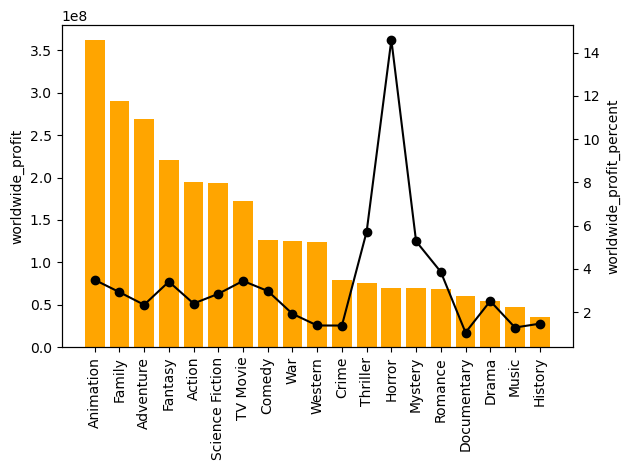

In [1842]:
x = mean_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.index
y1 = mean_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.worldwide_profit
y2 = mean_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.worldwide_profit_percent

fig, ax1 = plt.subplots()

# Bar chart
ax1.bar(x, y1, color='orange')
ax1.set_ylabel('worldwide_profit')
#create y-axis on the right:
ax2 = ax1.twinx()
# Line chart
ax2.plot(x, y2, marker='o', color='black')
ax2.set_ylabel('worldwide_profit_percent')
#format a-axis tick
ax1.set_xticks(range(len(x)))
ax1.set_xticklabels(x, rotation=90)
plt.tight_layout()
plt.show()

In [1844]:
mean_director_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit = merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.groupby('primary_name').mean(numeric_only = True).sort_values('worldwide_profit',ascending = False)[0:20]
mean_director_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.style.format({'runtime_minutes': '{:,.2f}','production_budget': '{:,.2f}','domestic_gross_y': '{:,.2f}', 'worldwide_gross': '{:,.2f}', 'international_gross': '{:,.2f}',
       'domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}','domestic_profit_percent': '{:.2%}','international_profit_percent': '{:.2%}', 'worldwide_profit_percent': '{:.2%}'})

,production_budget,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,runtime_minutes,domestic_gross_y,worldwide_gross,international_gross,release_month
primary_name,,,,,,,,,,,
Chi-kin Kwok,"150,000,000.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%,92.00,"400,738,009.00","1,272,469,910.00","871,731,901.00",11.000000
Chris Buck,"150,000,000.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%,102.00,"400,738,009.00","1,272,469,910.00","871,731,901.00",11.000000
Adam Green,"150,000,000.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%,93.00,"400,738,009.00","1,272,469,910.00","871,731,901.00",11.000000
Jennifer Lee,"150,000,000.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%,102.00,"400,738,009.00","1,272,469,910.00","871,731,901.00",11.000000
Joss Whedon,"330,600,000.00","613,408,095.00","1,072,413,963.00",38.84%,185.54%,324.38%,141.00,"459,005,868.00","1,403,013,963.00","944,008,095.00",5.000000
Anthony Russo,"240,000,000.00","611,986,237.67","1,060,868,500.67",80.77%,238.89%,419.66%,144.00,"448,882,263.00","1,300,868,500.67","851,986,237.67",4.333333
Joe Russo,"240,000,000.00","611,986,237.67","1,060,868,500.67",80.77%,238.89%,419.66%,144.00,"448,882,263.00","1,300,868,500.67","851,986,237.67",4.333333
Kyle Balda,"74,555,555.56","719,630,984.67","1,015,998,160.22",297.85%,965.52%,1363.36%,89.89,"296,367,175.56","1,090,553,715.78","794,186,540.22",6.444444
Eric Guillon,"75,000,000.00","695,103,450.00","959,727,750.00",252.83%,926.80%,1279.64%,89.00,"264,624,300.00","1,034,727,750.00","770,103,450.00",6.000000


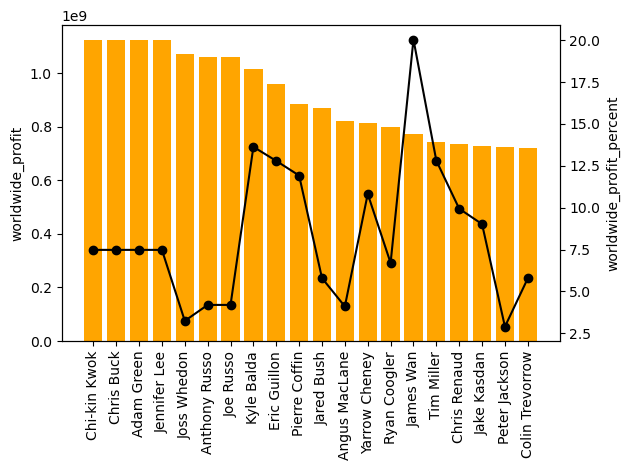

In [1814]:
x_director = mean_director_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.index
y1_director = mean_director_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.worldwide_profit
y2_director = mean_director_merge_genreid_split_dropna_merge_tmdb_movie_director_studio_profit.worldwide_profit_percent

fig, ax1 = plt.subplots()

# Bar chart
ax1.bar(x_director, y1_director, color='orange')
ax1.set_ylabel('worldwide_profit')
#create y-axis on the right:
ax2 = ax1.twinx()
# Line chart
ax2.plot(x_director, y2_director, marker='o', color='black')
ax2.set_ylabel('worldwide_profit_percent')
#format a-axis tick
ax1.set_xticks(range(len(x_director)))
ax1.set_xticklabels(x_director, rotation=90)
plt.tight_layout()
plt.show()

# Drop unnecessary cols:

In [1651]:

drop_movie_director_studio_profit = movie_director_studio_profit.drop (columns = ['movie_id', 'original_title', 'start_year',
                                                                       'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'birth_year', 'death_year',
       'primary_profession', 'title',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id', 'release_date', 'movie', 'release_year',
       'title_year'])

drop_movie_director_studio_profit.head()

,primary_title,runtime_minutes,genres,primary_name,each_genre,studio,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month
0,Sunghursh,175.0,"Action,Crime,Drama",Harnam Singh Rawail,"Action,Crime,Drama",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,One Day Before the Rainy Season,114.0,"Biography,Drama",Mani Kaul,"Biography,Drama",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,The Other Side of the Wind,122.0,Drama,Orson Welles,Drama,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Sabse Bada Sukh,NaN,"Comedy,Drama",Hrishikesh Mukherjee,"Comedy,Drama",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,The Wandering Soap Opera,80.0,"Comedy,Drama,Fantasy",Valeria Sarmiento,"Comedy,Drama,Fantasy",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1652]:
drop_movie_director_studio_profit.isna().sum()

primary_title                        0
runtime_minutes                  35973
genres                            5980
primary_name                      5732
each_genre                        5980
studio                          165642
production_budget               165229
domestic_gross_y                165229
worldwide_gross                 165229
international_gross             165229
domestic_profit                 165229
international_profit            165229
worldwide_profit                165229
domestic_profit_percent         165229
international_profit_percent    165229
worldwide_profit_percent        165229
release_month                   165229
dtype: int64

In [1654]:
dropna_movie_director_studio_profit = drop_movie_director_studio_profit.dropna(axis = "index")
dropna_movie_director_studio_profit.head()

,primary_title,runtime_minutes,genres,primary_name,each_genre,studio,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month
53,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,"Adventure,Drama,Romance",IFC,25000000.0,720828.0,9.313302e+06,8592474.0,-24279172.0,-16407526.0,-1.568670e+07,-0.971167,-0.656301,-0.627468,3.0
59,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,"Adventure,Comedy,Drama",Fox,91000000.0,58236838.0,1.878612e+08,129624345.0,-32763162.0,38624345.0,9.686118e+07,-0.360035,0.424443,1.064409,12.0
63,A Walk Among the Tombstones,114.0,"Action,Crime,Drama",Scott Frank,"Action,Crime,Drama",Uni.,28000000.0,26017685.0,6.210859e+07,36090902.0,-1982315.0,8090902.0,3.410859e+07,-0.070797,0.288961,1.218164,9.0
65,Jurassic World,124.0,"Action,Adventure,Sci-Fi",Colin Trevorrow,"Action,Adventure,Sci-Fi",Uni.,215000000.0,652270625.0,1.648855e+09,996584239.0,437270625.0,781584239.0,1.433855e+09,2.033817,3.635276,6.669092,6.0
67,The Rum Diary,119.0,"Comedy,Drama",Bruce Robinson,"Comedy,Drama",FD,45000000.0,13109815.0,2.154473e+07,8434917.0,-31890185.0,-36565083.0,-2.345527e+07,-0.708671,-0.812557,-0.521228,10.0


In [1655]:
dropna_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1661 entries, 53 to 169407
Data columns (total 17 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   primary_title                 1661 non-null   object 
 1   runtime_minutes               1661 non-null   float64
 2   genres                        1661 non-null   object 
 3   primary_name                  1661 non-null   object 
 4   each_genre                    1661 non-null   object 
 5   studio                        1661 non-null   object 
 6   production_budget             1661 non-null   float64
 7   domestic_gross_y              1661 non-null   float64
 8   worldwide_gross               1661 non-null   float64
 9   international_gross           1661 non-null   float64
 10  domestic_profit               1661 non-null   float64
 11  international_profit          1661 non-null   float64
 12  worldwide_profit              1661 non-null   float64
 13  domes

In [1658]:
dropna_movie_director_studio_profit.columns

Index(['primary_title', 'runtime_minutes', 'genres', 'primary_name',
       'each_genre', 'studio', 'production_budget', 'domestic_gross_y',
       'worldwide_gross', 'international_gross', 'domestic_profit',
       'international_profit', 'worldwide_profit', 'domestic_profit_percent',
       'international_profit_percent', 'worldwide_profit_percent',
       'release_month'],
      dtype='object')

In [1661]:
# split by genres
each_genre_dropna_movie_director_studio_profit = dropna_movie_director_studio_profit.set_index(['primary_title', 'runtime_minutes', 'genres', 'primary_name',
 'studio', 'production_budget', 'domestic_gross_y',
       'worldwide_gross', 'international_gross', 'domestic_profit',
       'international_profit', 'worldwide_profit', 'domestic_profit_percent',
       'international_profit_percent', 'worldwide_profit_percent',
       'release_month']).apply(lambda x: x.str.split(',').explode()).reset_index()
each_genre_dropna_movie_director_studio_profit.head()

,primary_title,runtime_minutes,genres,primary_name,studio,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,each_genre
0,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,Adventure
1,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,Drama
2,On the Road,124.0,"Adventure,Drama,Romance",Walter Salles,IFC,25000000.0,720828.0,9313302.0,8592474.0,-24279172.0,-16407526.0,-15686698.0,-0.971167,-0.656301,-0.627468,3.0,Romance
3,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,Adventure
4,The Secret Life of Walter Mitty,114.0,"Adventure,Comedy,Drama",Ben Stiller,Fox,91000000.0,58236838.0,187861183.0,129624345.0,-32763162.0,38624345.0,96861183.0,-0.360035,0.424443,1.064409,12.0,Comedy


In [1662]:
each_genre_dropna_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3976 entries, 0 to 3975
Data columns (total 17 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   primary_title                 3976 non-null   object 
 1   runtime_minutes               3976 non-null   float64
 2   genres                        3976 non-null   object 
 3   primary_name                  3976 non-null   object 
 4   studio                        3976 non-null   object 
 5   production_budget             3976 non-null   float64
 6   domestic_gross_y              3976 non-null   float64
 7   worldwide_gross               3976 non-null   float64
 8   international_gross           3976 non-null   float64
 9   domestic_profit               3976 non-null   float64
 10  international_profit          3976 non-null   float64
 11  worldwide_profit              3976 non-null   float64
 12  domestic_profit_percent       3976 non-null   float64
 13  int

In [1567]:
#Relationship between release_month & profit
col_list_month = ['domestic_gross_y', 'international_gross','worldwide_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit','domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent',
       'release_month',]
mean_movie_director_studio_profit = movie_director_studio_profit[col_list_month].groupby('release_month').mean(numeric_only = True).sort_values('worldwide_profit_percent',ascending = False)
mean_movie_director_studio_profit.style.format({'domestic_gross_y': '{:,.2f}', 'worldwide_gross': '{:,.2f}', 'international_gross': '{:,.2f}',
       'domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}','domestic_profit_percent': '{:.2%}','international_profit_percent': '{:.2%}', 'worldwide_profit_percent': '{:.2%}'})

,domestic_gross_y,international_gross,worldwide_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent
release_month,,,,,,,,,
4.000000,"30,568,235.63","48,100,484.33","78,668,719.96","3,406,738.18","20,938,986.88","51,507,222.51",66.46%,596.58%,763.04%
7.000000,"53,104,899.33","84,260,686.77","137,365,586.10","15,587,588.99","46,743,376.42","99,848,275.75",247.83%,228.25%,576.08%
2.000000,"39,727,668.71","41,913,627.21","81,641,295.92","9,895,994.79","12,081,953.28","51,809,622.00",231.09%,160.83%,491.93%
11.000000,"63,819,042.97","94,762,497.81","158,581,540.79","15,377,828.76","46,321,283.60","110,140,326.57",205.90%,141.42%,447.32%
1.000000,"29,014,130.53","31,525,559.82","60,539,690.34","6,320,864.10","8,832,293.39","37,846,423.92",175.28%,113.13%,388.41%
10.000000,"22,442,382.72","31,040,835.62","53,483,218.34","425,821.15","9,024,274.04","31,466,656.76",131.43%,133.76%,365.18%
8.000000,"27,100,805.10","28,197,074.63","55,297,879.73","3,881,467.79","4,977,737.32","32,078,542.41",94.78%,71.37%,266.15%
5.000000,"54,424,738.11","81,476,420.33","135,901,158.44","7,472,035.30","34,523,717.52","88,948,455.63",77.26%,19.34%,196.60%
12.000000,"39,069,884.45","51,724,272.25","90,794,156.70","10,729,998.63","23,384,386.43","62,454,270.88",63.31%,16.97%,180.28%


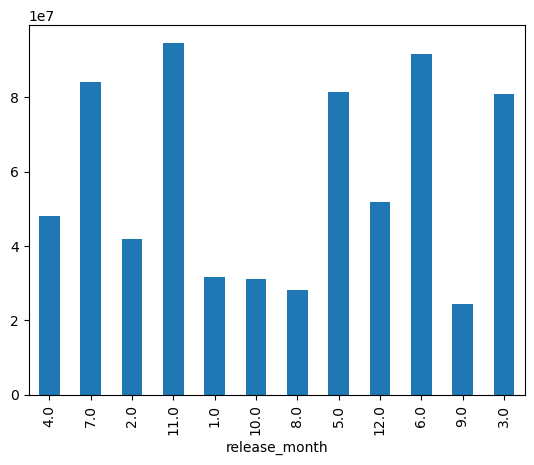

In [1568]:
mean_movie_director_studio_profit['international_gross'].plot(
    kind = 'bar')
plt.show()

In [1578]:
#Relationship between directors & profit

col_list1 = ['domestic_gross_y', 'international_gross','worldwide_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit','domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent',
       'primary_name',"movie"]
mean_director_movie_director_studio_profit = movie_director_studio_profit[col_list1].groupby('primary_name').mean(numeric_only = True).sort_values('worldwide_profit',ascending=False)
mean_director_movie_director_studio_profit.style.format({'domestic_gross_y': '{:,.2f}', 'worldwide_gross': '{:,.2f}', 'international_gross': '{:,.2f}',
       'domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}','domestic_profit_percent': '{:.2%}','international_profit_percent': '{:.2%}', 'worldwide_profit_percent': '{:.2%}'})

,domestic_gross_y,international_gross,worldwide_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent
primary_name,,,,,,,,,
Atsushi Wada,"760,507,625.00","2,015,837,654.00","2,776,345,279.00","335,507,625.00","1,590,837,654.00","2,351,345,279.00",78.94%,374.31%,553.26%
Pete Meads,"659,363,944.00","1,548,844,451.00","2,208,208,395.00","459,363,944.00","1,348,844,451.00","2,008,208,395.00",229.68%,674.42%,1004.10%
Ravi Punj,"659,363,944.00","1,548,844,451.00","2,208,208,395.00","459,363,944.00","1,348,844,451.00","2,008,208,395.00",229.68%,674.42%,1004.10%
Kevin Lincoln,"659,363,944.00","1,548,844,451.00","2,208,208,395.00","459,363,944.00","1,348,844,451.00","2,008,208,395.00",229.68%,674.42%,1004.10%
Chris Buck,"400,738,009.00","871,731,901.00","1,272,469,910.00","250,738,009.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%
Adam Green,"400,738,009.00","871,731,901.00","1,272,469,910.00","250,738,009.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%
Chi-kin Kwok,"400,738,009.00","871,731,901.00","1,272,469,910.00","250,738,009.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%
Jennifer Lee,"400,738,009.00","871,731,901.00","1,272,469,910.00","250,738,009.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%
Anthony Russo,"448,882,263.00","851,986,237.67","1,300,868,500.67","208,882,263.00","611,986,237.67","1,060,868,500.67",80.77%,238.89%,419.66%


In [1584]:
#Use for the group
col_list2 = ['domestic_gross_y', 'international_gross','worldwide_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit','domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent','primary_name','genres']
mean_group_director_movie_director_studio_profit = movie_director_studio_profit[col_list2].groupby('genres').mean(numeric_only = True).sort_values('worldwide_profit',ascending=False)
mean_group_director_movie_director_studio_profit.style.format({'domestic_gross_y': '{:,.2f}', 'worldwide_gross': '{:,.2f}', 'international_gross': '{:,.2f}',
       'domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}', 'domestic_profit_percent': '{:.2%}','international_profit_percent': '{:.2%}', 'worldwide_profit_percent': '{:.2%}'})

,domestic_gross_y,international_gross,worldwide_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent
genres,,,,,,,,,
"Adventure,Drama,Sport","400,738,009.00","871,731,901.00","1,272,469,910.00","250,738,009.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%
"Fantasy,Romance","400,738,009.00","871,731,901.00","1,272,469,910.00","250,738,009.00","721,731,901.00","1,122,469,910.00",167.16%,481.15%,748.31%
"Family,Fantasy,Musical","440,035,715.50","493,779,703.50","933,815,419.00","350,035,715.50","403,779,703.50","843,815,419.00",997.65%,716.93%,1814.58%
"Adventure,Fantasy","192,891,415.33","508,319,277.67","701,210,693.00","-38,775,251.33","276,652,611.00","469,544,026.33",-20.39%,108.31%,187.92%
"Action,Adventure,Sci-Fi","231,736,743.37","402,504,551.65","634,241,295.02","66,825,632.25","237,593,440.54","469,330,183.90",40.22%,126.94%,267.17%
"Adventure,Animation,Drama","198,062,771.67","314,082,430.33","512,145,202.00","97,462,771.67","213,482,430.33","411,545,202.00",117.19%,244.28%,461.47%
"Fantasy,Musical","167,095,555.00","345,650,000.00","512,745,555.00","65,595,555.00","244,150,000.00","411,245,555.00",-16.45%,72.83%,156.37%
"Documentary,Thriller","187,683,805.00","270,000,000.00","457,683,805.00","84,683,805.00","167,000,000.00","354,683,805.00",82.22%,162.14%,344.35%
"Drama,Family,Fantasy","143,075,676.50","255,995,707.50","399,071,384.00","94,125,676.50","207,045,707.50","350,121,384.00",1471.39%,3154.64%,4726.02%


In [1585]:
movie_director_studio_profit.columns

Index(['movie_id', 'primary_title', 'original_title', 'start_year',
       'runtime_minutes', 'genres', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'primary_name', 'birth_year', 'death_year',
       'primary_profession', 'each_genre', 'title', 'studio',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id', 'release_date', 'movie', 'production_budget',
       'domestic_gross_y', 'worldwide_gross', 'international_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit',
       'domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent', 'release_month', 'release_year',
       'title_year'],
      dtype='object')

In [1621]:
#split genres in each genres
split_movie_director_studio_profit = movie_director_studio_profit.set_index(['movie_id', 'primary_title', 'original_title', 'start_year',
       'runtime_minutes', 'genres', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'primary_name', 'birth_year', 'death_year',
       'primary_profession', 'title', 'studio',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id', 'release_date', 'movie', 'production_budget',
       'domestic_gross_y', 'worldwide_gross', 'international_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit',
       'domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent', 'release_month', 'release_year',
       'title_year']).apply(lambda x: x.str.split(',').explode()).reset_index()
split_movie_director_studio_profit.head()

,movie_id,primary_title,original_title,start_year,runtime_minutes,genres,title_year_x,person_id_x,directorid,person_id_y,...,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,release_month,release_year,title_year,each_genre
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Action
1,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Crime
2,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Drama
3,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019,nm0002411,nm0002411,nm0002411,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Biography
4,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019,nm0002411,nm0002411,nm0002411,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Drama


In [1630]:
#Drop columns:
drop_split_movie_director_studio_profit = split_movie_director_studio_profit.drop(columns = ['movie_id', 'primary_title', 'original_title', 'start_year',
       'runtime_minutes', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'birth_year', 'death_year',
       'primary_profession', 'title', 'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id', 'release_date', 'movie',  'release_month', 'release_year','title_year'])
drop_split_movie_director_studio_profit.head()

,genres,primary_name,studio,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,each_genre
0,"Action,Crime,Drama",Harnam Singh Rawail,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Action
1,"Action,Crime,Drama",Harnam Singh Rawail,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Crime
2,"Action,Crime,Drama",Harnam Singh Rawail,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Drama
3,"Biography,Drama",Mani Kaul,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Biography
4,"Biography,Drama",Mani Kaul,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Drama


In [1631]:
drop_split_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 274429 entries, 0 to 274428
Data columns (total 14 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   genres                        268449 non-null  object 
 1   primary_name                  267277 non-null  object 
 2   studio                        8446 non-null    object 
 3   production_budget             8696 non-null    float64
 4   domestic_gross_y              8696 non-null    float64
 5   worldwide_gross               8696 non-null    float64
 6   international_gross           8696 non-null    float64
 7   domestic_profit               8696 non-null    float64
 8   international_profit          8696 non-null    float64
 9   worldwide_profit              8696 non-null    float64
 10  domestic_profit_percent       8696 non-null    float64
 11  international_profit_percent  8696 non-null    float64
 12  worldwide_profit_percent      8696 non-null 

In [1632]:
drop_split_movie_director_studio_profit.isna().sum()

genres                            5980
primary_name                      7152
studio                          265983
production_budget               265733
domestic_gross_y                265733
worldwide_gross                 265733
international_gross             265733
domestic_profit                 265733
international_profit            265733
worldwide_profit                265733
domestic_profit_percent         265733
international_profit_percent    265733
worldwide_profit_percent        265733
each_genre                        5980
dtype: int64

In [1642]:
drop_split_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 274429 entries, 0 to 274428
Data columns (total 14 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   genres                        268449 non-null  object 
 1   primary_name                  267277 non-null  object 
 2   studio                        8446 non-null    object 
 3   production_budget             8696 non-null    float64
 4   domestic_gross_y              8696 non-null    float64
 5   worldwide_gross               8696 non-null    float64
 6   international_gross           8696 non-null    float64
 7   domestic_profit               8696 non-null    float64
 8   international_profit          8696 non-null    float64
 9   worldwide_profit              8696 non-null    float64
 10  domestic_profit_percent       8696 non-null    float64
 11  international_profit_percent  8696 non-null    float64
 12  worldwide_profit_percent      8696 non-null 

In [1588]:
col_split3 = ['domestic_gross_y', 'international_gross','worldwide_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit','domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent', 'primary_name',"each_genre",]
mean_split_movie_director_studio_profit = split_movie_director_studio_profit[col_split3].groupby(['each_genre',"primary_name"]).mean(numeric_only=True).sort_values('worldwide_profit',ascending=False)
mean_split_movie_director_studio_profit.head(30).style.format({'domestic_gross_y': '{:,.2f}', 'worldwide_gross': '{:,.2f}', 'international_gross': '{:,.2f}',
       'domestic_profit': '{:,.2f}','international_profit': '{:,.2f}','worldwide_profit': '{:,.2f}','domestic_profit_percent': '{:.2%}','international_profit_percent': '{:.2%}', 'worldwide_profit_percent': '{:.2%}'})


,,domestic_gross_y,international_gross,worldwide_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent
each_genre,primary_name,,,,,,,,,
Horror,Atsushi Wada,"760,507,625.00","2,015,837,654.00","2,776,345,279.00","335,507,625.00","1,590,837,654.00","2,351,345,279.00",78.94%,374.31%,553.26%
Adventure,Kevin Lincoln,"659,363,944.00","1,548,844,451.00","2,208,208,395.00","459,363,944.00","1,348,844,451.00","2,008,208,395.00",229.68%,674.42%,1004.10%
Family,Ravi Punj,"659,363,944.00","1,548,844,451.00","2,208,208,395.00","459,363,944.00","1,348,844,451.00","2,008,208,395.00",229.68%,674.42%,1004.10%
Adventure,Pete Meads,"659,363,944.00","1,548,844,451.00","2,208,208,395.00","459,363,944.00","1,348,844,451.00","2,008,208,395.00",229.68%,674.42%,1004.10%
Sci-Fi,Colin Trevorrow,"652,270,625.00","996,584,239.00","1,648,854,864.00","437,270,625.00","781,584,239.00","1,433,854,864.00",203.38%,363.53%,666.91%
Action,Colin Trevorrow,"652,270,625.00","996,584,239.00","1,648,854,864.00","437,270,625.00","781,584,239.00","1,433,854,864.00",203.38%,363.53%,666.91%
Adventure,Colin Trevorrow,"652,270,625.00","996,584,239.00","1,648,854,864.00","437,270,625.00","781,584,239.00","1,433,854,864.00",203.38%,363.53%,666.91%
Crime,James Wan,"353,007,020.00","1,165,715,774.00","1,518,722,794.00","163,007,020.00","975,715,774.00","1,328,722,794.00",85.79%,513.53%,699.33%
Action,James Wan,"344,034,413.50","988,774,303.50","1,332,808,717.00","169,034,413.50","813,774,303.50","1,157,808,717.00",97.60%,460.47%,658.07%


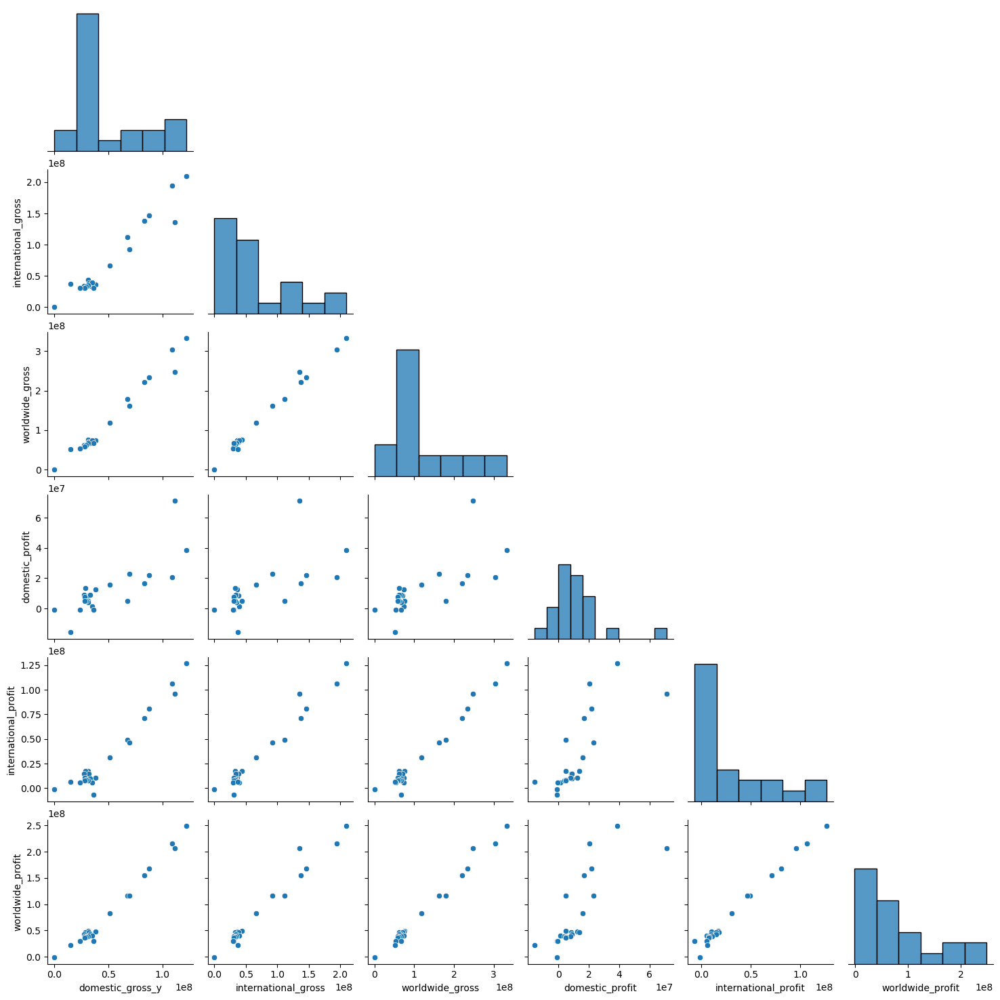

In [1499]:
sns.pairplot(mean_split_movie_director_studio_profit, corner = True)
plt.show()

In [1279]:
col = ['movie_id', 'runtime_minutes', 'genres', 'person_id_x',
       'primary_name', 'primary_profession']
movie_basics_director[col].groupby(['genres','primary_name']).mean(numeric_only=True)

runtime_minutes
genres  primary_name                        
Action  A'Ali de Sousa                  81.0
        A. Mahadev                     153.0
        A. Majid                       115.0
        A. Venkatesh                   134.0
        Aadhitya Bahudhanam            103.0
...                                      ...
Western Tony London                     87.0
        Travis Mills                    89.0
        Vernon E. Mortensen             92.0
        Wayne Shipley                  128.0
        William F. Miller               94.0

[115035 rows x 1 columns]

In [1634]:
split2_movie_director_studio_profit = pd.merge(movie_director_studio_profit, tmdb_movie_genres, left_on ="primary_title", right_on = "title", how = "left")
split2_movie_director_studio_profit.head()

,movie_id,primary_title,original_title_x,start_year,runtime_minutes,genres,title_year_x,person_id_x,directorid,person_id_y,...,original_language,original_title_y,popularity,release_date_y,title_y,vote_average,vote_count,each_genre_id,Genre type,Genre code
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama",Sunghursh2013,nm0712540,nm0712540,nm0712540,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama",One Day Before the Rainy Season2019,nm0002411,nm0002411,nm0002411,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018,nm0000080,nm0000080,nm0000080,...,en,The Other Side of the Wind,9.8,2018-11-02,The Other Side of the Wind,7.0,64.0,35,Comedy,35
3,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama,The Other Side of the Wind2018,nm0000080,nm0000080,nm0000080,...,en,The Other Side of the Wind,9.8,2018-11-02,The Other Side of the Wind,7.0,64.0,18,Drama,18
4,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama",Sabse Bada Sukh2018,nm0611531,nm0611531,nm0611531,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1635]:
split2_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 198733 entries, 0 to 198732
Data columns (total 51 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   movie_id                      198733 non-null  object 
 1   primary_title                 198733 non-null  object 
 2   original_title_x              198709 non-null  object 
 3   start_year                    198733 non-null  int64  
 4   runtime_minutes               160398 non-null  float64
 5   genres                        192329 non-null  object 
 6   title_year_x                  198733 non-null  object 
 7   person_id_x                   192549 non-null  object 
 8   directorid                    192549 non-null  object 
 9   person_id_y                   192547 non-null  object 
 10  primary_name                  192547 non-null  object 
 11  birth_year                    44762 non-null   float64
 12  death_year                    1129 non-null 

In [1636]:
split2_movie_director_studio_profit.columns

Index(['movie_id', 'primary_title', 'original_title_x', 'start_year',
       'runtime_minutes', 'genres', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'primary_name', 'birth_year', 'death_year',
       'primary_profession', 'each_genre', 'title_x', 'studio',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id_x', 'release_date_x', 'movie', 'production_budget',
       'domestic_gross_y', 'worldwide_gross', 'international_gross',
       'domestic_profit', 'international_profit', 'worldwide_profit',
       'domestic_profit_percent', 'international_profit_percent',
       'worldwide_profit_percent', 'release_month', 'release_year',
       'title_year', 'Unnamed: 0', 'genre_ids', 'id_y', 'original_language',
       'original_title_y', 'popularity', 'release_date_y', 'title_y',
       'vote_average', 'vote_count', 'each_genre_id', 'Genre type',
       'Genre code'],
      dtype='object')

In [1640]:
drop_split2_movie_director_studio_profit = split2_movie_director_studio_profit.drop (columns = ['movie_id', 'primary_title', 'original_title_x', 'start_year',
       'runtime_minutes', 'genres', 'title_year_x', 'person_id_x',
       'directorid', 'person_id_y', 'birth_year', 'death_year',
       'primary_profession', 'each_genre', 'title_x',
       'domestic_gross_x', 'foreign_gross', 'year', 'title_year_y',
       'titleyear', 'id_x', 'release_date_x', 'movie', 'release_month', 'release_year',
       'title_year', 'Unnamed: 0', 'genre_ids', 'id_y', 'original_language',
       'original_title_y', 'popularity', 'release_date_y', 'title_y',
       'vote_average', 'vote_count', 'each_genre_id',
       'Genre code'])
drop_split2_movie_director_studio_profit.head()

,primary_name,studio,production_budget,domestic_gross_y,worldwide_gross,international_gross,domestic_profit,international_profit,worldwide_profit,domestic_profit_percent,international_profit_percent,worldwide_profit_percent,Genre type
0,Harnam Singh Rawail,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Mani Kaul,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Orson Welles,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Comedy
3,Orson Welles,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Drama
4,Hrishikesh Mukherjee,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1641]:
drop_split2_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 198733 entries, 0 to 198732
Data columns (total 13 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   primary_name                  192547 non-null  object 
 1   studio                        10285 non-null   object 
 2   production_budget             11879 non-null   float64
 3   domestic_gross_y              11879 non-null   float64
 4   worldwide_gross               11879 non-null   float64
 5   international_gross           11879 non-null   float64
 6   domestic_profit               11879 non-null   float64
 7   international_profit          11879 non-null   float64
 8   worldwide_profit              11879 non-null   float64
 9   domestic_profit_percent       11879 non-null   float64
 10  international_profit_percent  11879 non-null   float64
 11  worldwide_profit_percent      11879 non-null   float64
 12  Genre type                    50128 non-null

In [1643]:
drop_split2_movie_director_studio_profit.isna().sum()

primary_name                      6186
studio                          188448
production_budget               186854
domestic_gross_y                186854
worldwide_gross                 186854
international_gross             186854
domestic_profit                 186854
international_profit            186854
worldwide_profit                186854
domestic_profit_percent         186854
international_profit_percent    186854
worldwide_profit_percent        186854
Genre type                      148605
dtype: int64

In [1644]:
dropna_split2_movie_director_studio_profit = drop_split2_movie_director_studio_profit.dropna(axis='index')

In [1645]:
dropna_split2_movie_director_studio_profit.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5391 entries, 72 to 198645
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   primary_name                  5391 non-null   object 
 1   studio                        5391 non-null   object 
 2   production_budget             5391 non-null   float64
 3   domestic_gross_y              5391 non-null   float64
 4   worldwide_gross               5391 non-null   float64
 5   international_gross           5391 non-null   float64
 6   domestic_profit               5391 non-null   float64
 7   international_profit          5391 non-null   float64
 8   worldwide_profit              5391 non-null   float64
 9   domestic_profit_percent       5391 non-null   float64
 10  international_profit_percent  5391 non-null   float64
 11  worldwide_profit_percent      5391 non-null   float64
 12  Genre type                    5391 non-null   object 
dtypes: fl

# 6.7. persons

In [97]:
persons_df = pd.read_sql("""
SELECT *
FROM persons
""", con)

In [999]:
persons_df.shape

(606648, 5)

In [98]:
persons_df.head()

,person_id,primary_name,birth_year,death_year,primary_profession
0,nm0061671,Mary Ellen Bauder,NaN,NaN,"miscellaneous,production_manager,producer"
1,nm0061865,Joseph Bauer,NaN,NaN,"composer,music_department,sound_department"
2,nm0062070,Bruce Baum,NaN,NaN,"miscellaneous,actor,writer"
3,nm0062195,Axel Baumann,NaN,NaN,"camera_department,cinematographer,art_department"
4,nm0062798,Pete Baxter,NaN,NaN,"production_designer,art_department,set_decorator"


In [1203]:
persons_df = persons_df.drop_duplicates(keep='first', ignore_index=False)
persons_df.head()

,person_id,primary_name,birth_year,death_year,primary_profession
0,nm0061671,Mary Ellen Bauder,NaN,NaN,"miscellaneous,production_manager,producer"
1,nm0061865,Joseph Bauer,NaN,NaN,"composer,music_department,sound_department"
2,nm0062070,Bruce Baum,NaN,NaN,"miscellaneous,actor,writer"
3,nm0062195,Axel Baumann,NaN,NaN,"camera_department,cinematographer,art_department"
4,nm0062798,Pete Baxter,NaN,NaN,"production_designer,art_department,set_decorator"


# 6.8. writers

In [99]:
writers_df = pd.read_sql("""
SELECT *
FROM writers
""", con)

In [1000]:
writers_df.shape

(255873, 2)

In [100]:
writers_df.head()

,movie_id,person_id
0,tt0285252,nm0899854
1,tt0438973,nm0175726
2,tt0438973,nm1802864
3,tt0462036,nm1940585
4,tt0835418,nm0310087


# 7. Genrelookup from https://www.themoviedb.org/talk/5daf6eb0ae36680011d7e6ee

In [914]:
genre_lookup_df = pd.read_csv('zippedData/genrelookup-internet.csv')

In [972]:
lookup_dict = genre_lookup_df.set_index('Genre code').to_dict()['Genre type']
lookup_dict

{'28': 'Action',
 '12': 'Adventure',
 '16': 'Animation',
 '35': 'Comedy',
 '80': 'Crime',
 '99': 'Documentary',
 '18': 'Drama',
 '10751': 'Family',
 '14': 'Fantasy',
 '36': 'History',
 '27': 'Horror',
 '10402': 'Music',
 '9648': 'Mystery',
 '10749': 'Romance',
 '878': 'Science Fiction',
 '10770': 'TV Movie',
 '53': 'Thriller',
 '10752': 'War',
 '37': 'Western'}

In [974]:
tmdb_movie['each_genre_id'].str.strip().map(lookup_dict) 

0        Adventure
1          Fantasy
2           Family
3          Fantasy
4        Adventure
           ...    
47829       Family
47830    Adventure
47831       Action
47832     Thriller
47833       Horror
Name: each_genre_id, Length: 47834, dtype: object

In [921]:
genre_lookup_df['Genre code'] = genre_lookup_df['Genre code'].astype(str)

In [922]:
genre_lookup_df.head()

,Genre type,Genre code
0,Action,28
1,Adventure,12
2,Animation,16
3,Comedy,35
4,Crime,80


In [923]:
genre_lookup_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19 entries, 0 to 18
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Genre type  19 non-null     object
 1   Genre code  19 non-null     object
dtypes: object(2)
memory usage: 432.0+ bytes
